In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
import warnings
warnings.filterwarnings('ignore')

In [4]:
df = pd.read_csv("/content/water_quality.csv")

# Exploratory data analysis

In [5]:
df.head()

,ph,Hardness,Solids,Chloramines,Sulfate,Conductivity,Organic_carbon,Trihalomethanes,Turbidity,Potability
0,NaN,204.890456,20791.31898,7.300212,368.516441,564.308654,10.379783,86.990970,2.963135,0
1,3.716080,129.422921,18630.05786,6.635246,NaN,592.885359,15.180013,56.329076,4.500656,0
2,8.099124,224.236259,19909.54173,9.275884,NaN,418.606213,16.868637,66.420093,3.055934,0
3,8.316766,214.373394,22018.41744,8.059332,356.886136,363.266516,18.436525,100.341674,4.628771,0
4,9.092223,181.101509,17978.98634,6.546600,310.135738,398.410813,11.558279,31.997993,4.075075,0


In [6]:
df.tail()

,ph,Hardness,Solids,Chloramines,Sulfate,Conductivity,Organic_carbon,Trihalomethanes,Turbidity,Potability
3271,4.668102,193.681736,47580.99160,7.166639,359.948574,526.424171,13.894419,66.687695,4.435821,1
3272,7.808856,193.553212,17329.80216,8.061362,NaN,392.449580,19.903225,NaN,2.798243,1
3273,9.419510,175.762646,33155.57822,7.350233,NaN,432.044783,11.039070,69.845400,3.298875,1
3274,5.126763,230.603758,11983.86938,6.303357,NaN,402.883113,11.168946,77.488213,4.708658,1
3275,7.874671,195.102299,17404.17706,7.509306,NaN,327.459761,16.140368,78.698446,2.309149,1


In [7]:
df.shape

(3276, 10)

In [8]:
df.columns

Index(['ph', 'Hardness', 'Solids', 'Chloramines', 'Sulfate', 'Conductivity',
       'Organic_carbon', 'Trihalomethanes', 'Turbidity', 'Potability'],
      dtype='object')

In [9]:
df.duplicated().sum()

0

In [10]:
df.isnull().sum()

ph                 491
Hardness             0
Solids               0
Chloramines          0
Sulfate            781
Conductivity         0
Organic_carbon       0
Trihalomethanes    162
Turbidity            0
Potability           0
dtype: int64

In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3276 entries, 0 to 3275
Data columns (total 10 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   ph               2785 non-null   float64
 1   Hardness         3276 non-null   float64
 2   Solids           3276 non-null   float64
 3   Chloramines      3276 non-null   float64
 4   Sulfate          2495 non-null   float64
 5   Conductivity     3276 non-null   float64
 6   Organic_carbon   3276 non-null   float64
 7   Trihalomethanes  3114 non-null   float64
 8   Turbidity        3276 non-null   float64
 9   Potability       3276 non-null   int64  
dtypes: float64(9), int64(1)
memory usage: 256.1 KB


In [12]:
df.describe()

,ph,Hardness,Solids,Chloramines,Sulfate,Conductivity,Organic_carbon,Trihalomethanes,Turbidity,Potability
count,2785.000000,3276.000000,3276.000000,3276.000000,2495.000000,3276.000000,3276.000000,3114.000000,3276.000000,3276.000000
mean,7.080795,196.369496,22014.092526,7.122277,333.775777,426.205111,14.284970,66.396293,3.966786,0.390110
std,1.594320,32.879761,8768.570828,1.583085,41.416840,80.824064,3.308162,16.175008,0.780382,0.487849
min,0.000000,47.432000,320.942611,0.352000,129.000000,181.483754,2.200000,0.738000,1.450000,0.000000
25%,6.093092,176.850538,15666.690300,6.127421,307.699498,365.734414,12.065801,55.844536,3.439711,0.000000
50%,7.036752,196.967627,20927.833605,7.130299,333.073546,421.884968,14.218338,66.622485,3.955028,0.000000
75%,8.062066,216.667456,27332.762125,8.114887,359.950170,481.792305,16.557652,77.337473,4.500320,1.000000
max,14.000000,323.124000,61227.196010,13.127000,481.030642,753.342620,28.300000,124.000000,6.739000,1.000000


In [13]:
df.nunique()

ph                 2785
Hardness           3276
Solids             3276
Chloramines        3276
Sulfate            2495
Conductivity       3276
Organic_carbon     3276
Trihalomethanes    3114
Turbidity          3276
Potability            2
dtype: int64

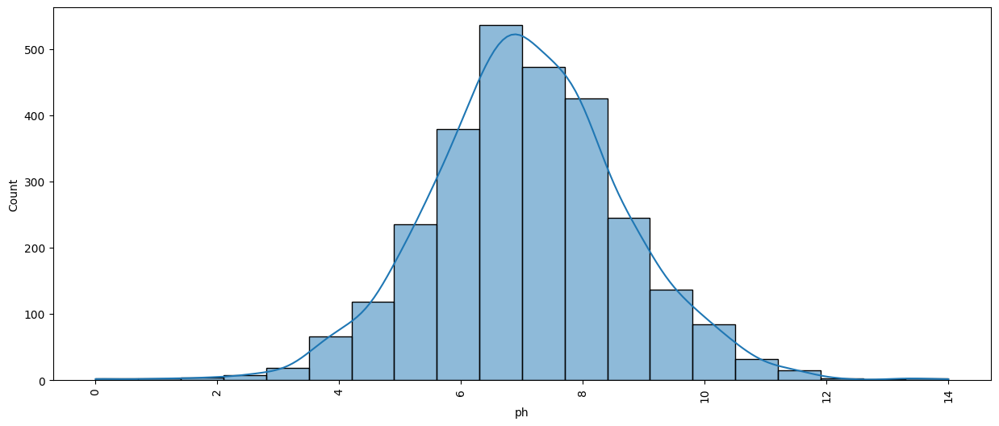

In [14]:
plt.figure(figsize=(15,6))
sns.histplot(df['ph'], bins = 20, kde = True, palette='hls')
plt.xticks(rotation = 90)
plt.show()

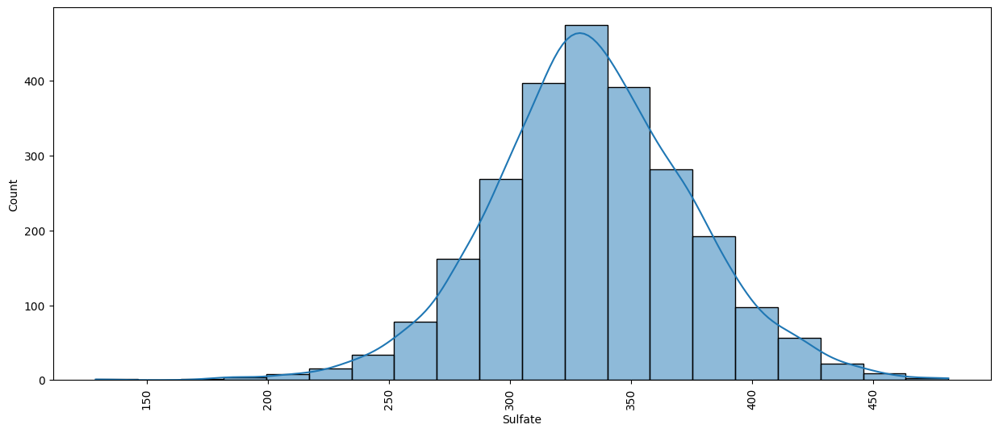

In [15]:
plt.figure(figsize=(15,6))
sns.histplot(df['Sulfate'], bins = 20, kde = True, palette='hls')
plt.xticks(rotation = 90)
plt.show()

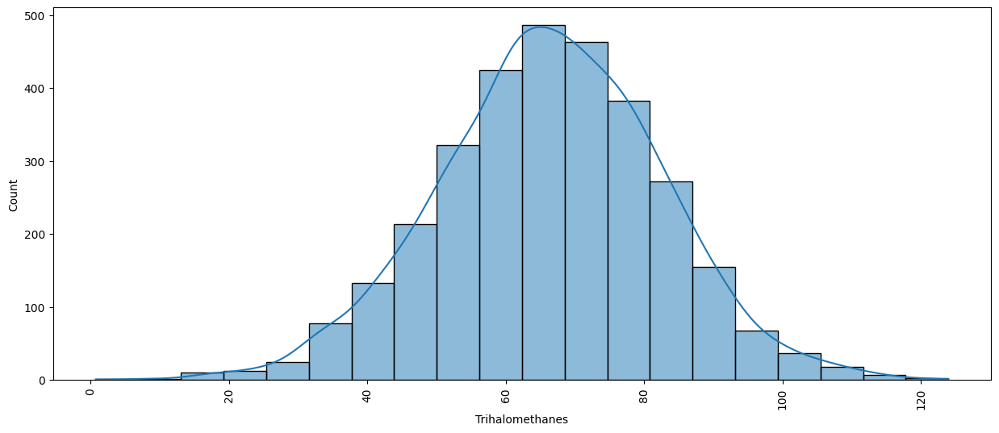

In [16]:
plt.figure(figsize=(15,6))
sns.histplot(df['Trihalomethanes'], bins = 20, kde = True, palette='hls')
plt.xticks(rotation = 90)
plt.show()

### data cleaning

In [17]:
ph_median = df['ph'].median()
sulfate_median = df['Sulfate'].median()
trihalomethanes_median = df['Trihalomethanes'].median()

df['ph'].fillna(ph_median, inplace=True)
df['Sulfate'].fillna(sulfate_median, inplace=True)
df['Trihalomethanes'].fillna(trihalomethanes_median, inplace=True)

In [18]:
df.isnull().sum()

ph                 0
Hardness           0
Solids             0
Chloramines        0
Sulfate            0
Conductivity       0
Organic_carbon     0
Trihalomethanes    0
Turbidity          0
Potability         0
dtype: int64

#Data Visualization

## Univariate analysis

In [19]:
object_columns = df.select_dtypes(include=['object']).columns
print("Object type columns:")
print(object_columns)

numerical_columns = df.select_dtypes(include=['int64', 'float64']).columns
print("\nNumerical type columns:")
print(numerical_columns)

Object type columns:
Index([], dtype='object')

Numerical type columns:
Index(['ph', 'Hardness', 'Solids', 'Chloramines', 'Sulfate', 'Conductivity',
       'Organic_carbon', 'Trihalomethanes', 'Turbidity', 'Potability'],
      dtype='object')


In [20]:
def classify_features(df):
    categorical_features = []
    non_categorical_features = []
    discrete_features = []
    continuous_features = []

    for column in df.columns:
        if df[column].dtype == 'object':
            if df[column].nunique() < 10:
                categorical_features.append(column)
            else:
                non_categorical_features.append(column)
        elif df[column].dtype in ['int64', 'float64']:
            if df[column].nunique() < 15:
                discrete_features.append(column)
            else:
                continuous_features.append(column)

    return categorical_features, non_categorical_features, discrete_features, continuous_features

In [21]:
categorical, non_categorical, discrete, continuous = classify_features(df)

In [22]:
print("Categorical Features:", categorical)
print("Non-Categorical Features:", non_categorical)
print("Discrete Features:", discrete)
print("Continuous Features:", continuous)

Categorical Features: []
Non-Categorical Features: []
Discrete Features: ['Potability']
Continuous Features: ['ph', 'Hardness', 'Solids', 'Chloramines', 'Sulfate', 'Conductivity', 'Organic_carbon', 'Trihalomethanes', 'Turbidity']


In [23]:
for i in discrete:
    print(i)
    print(df[i].unique())
    print()

Potability
[0 1]



In [24]:
for i in discrete:
    print(df[i].value_counts())
    print()

Potability
0    1998
1    1278
Name: count, dtype: int64



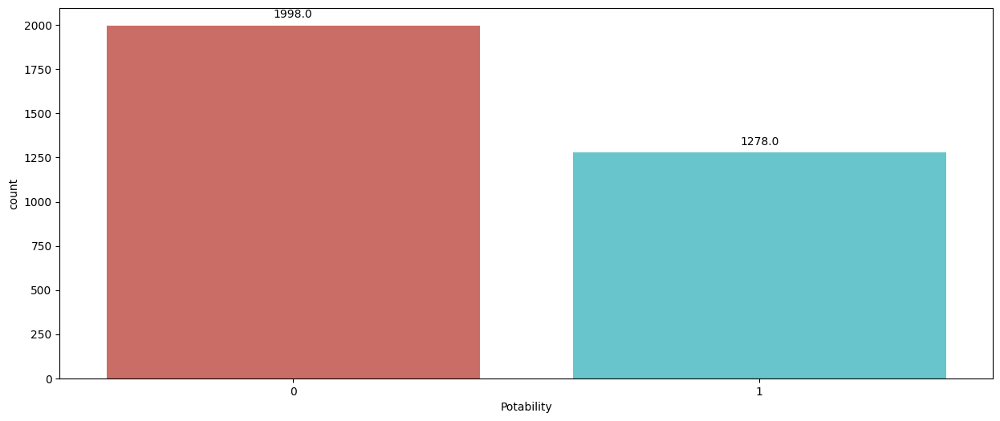

In [25]:
for i in discrete:
    plt.figure(figsize=(15, 6))
    ax = sns.countplot(x=i, data=df, palette='hls')

    for p in ax.patches:
        height = p.get_height()
        ax.annotate(f'{height}',
                    xy=(p.get_x() + p.get_width() / 2., height),
                    xytext=(0, 10),
                    textcoords='offset points',
                    ha='center', va='center')

    plt.show()

In [26]:
import plotly.express as px

for i in discrete:
    counts = df[i].value_counts()
    fig = px.pie(counts, values=counts.values, names=counts.index, title=f'Distribution of {i}')
    fig.show()

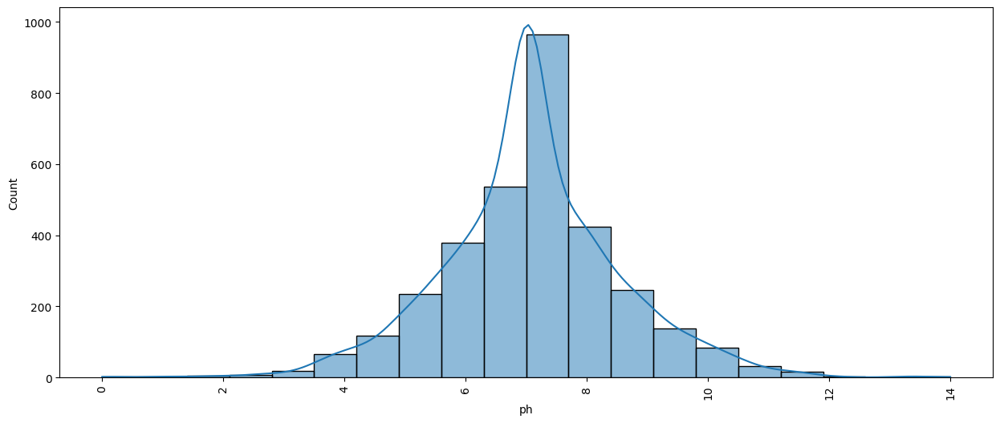

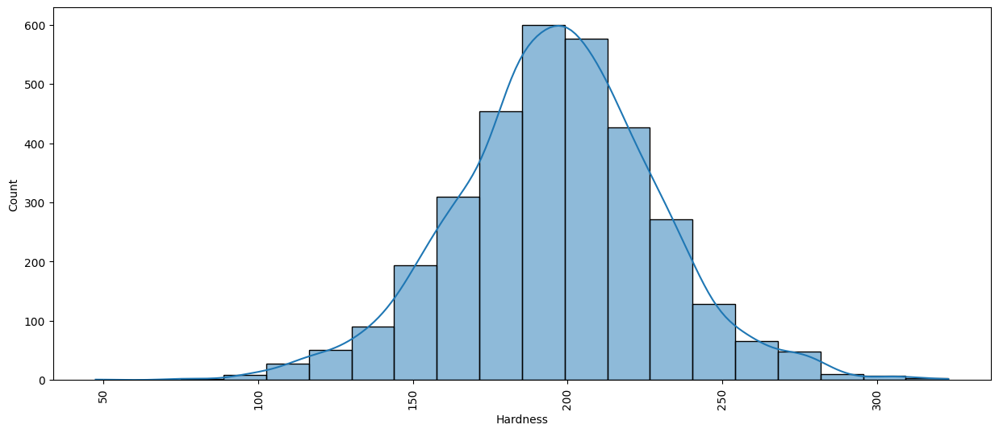

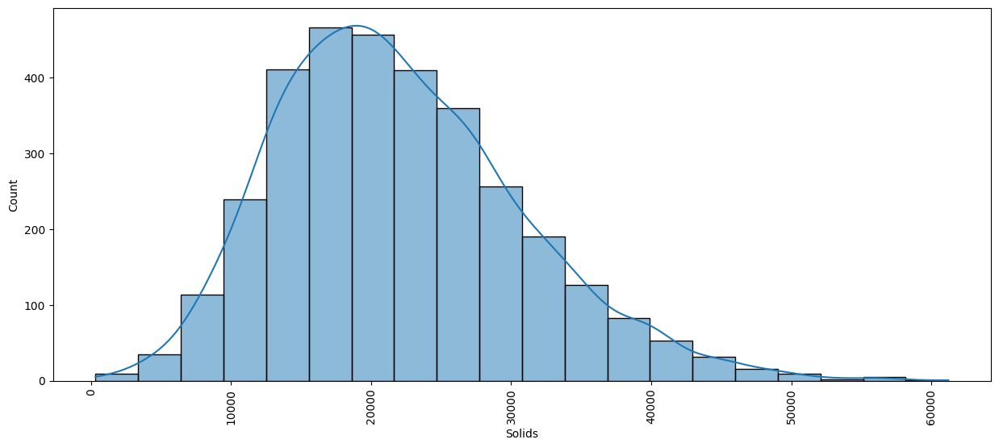

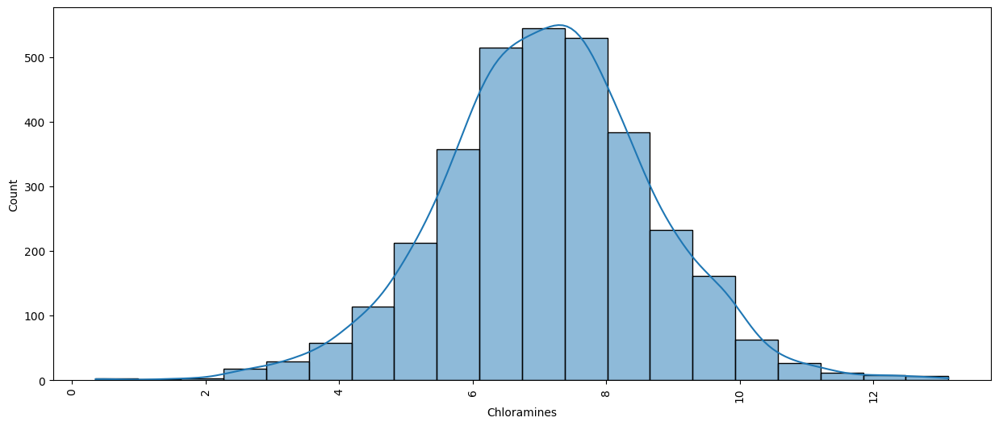

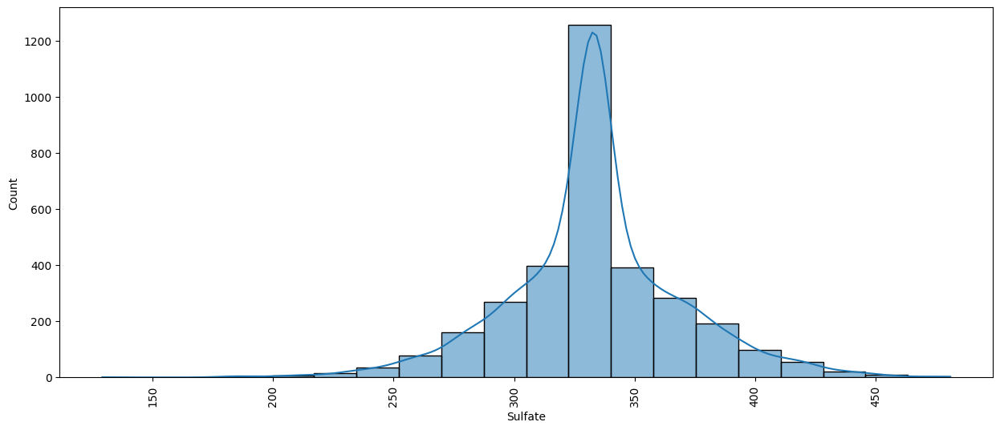

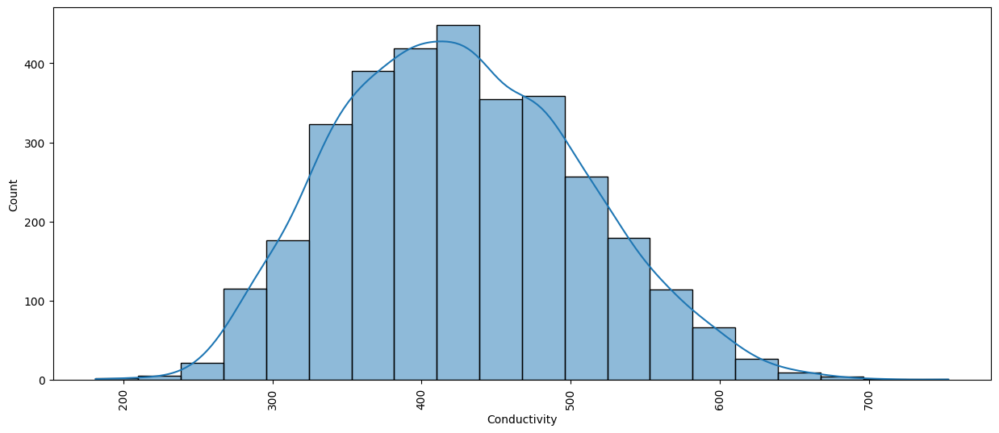

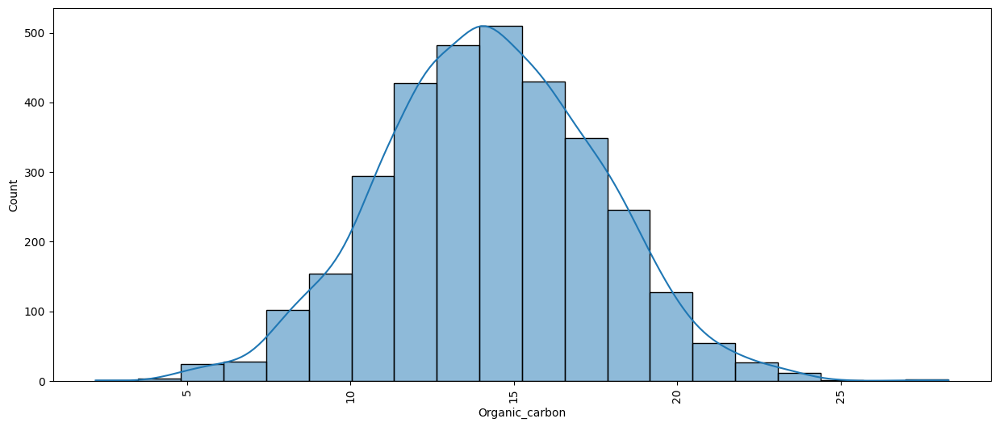

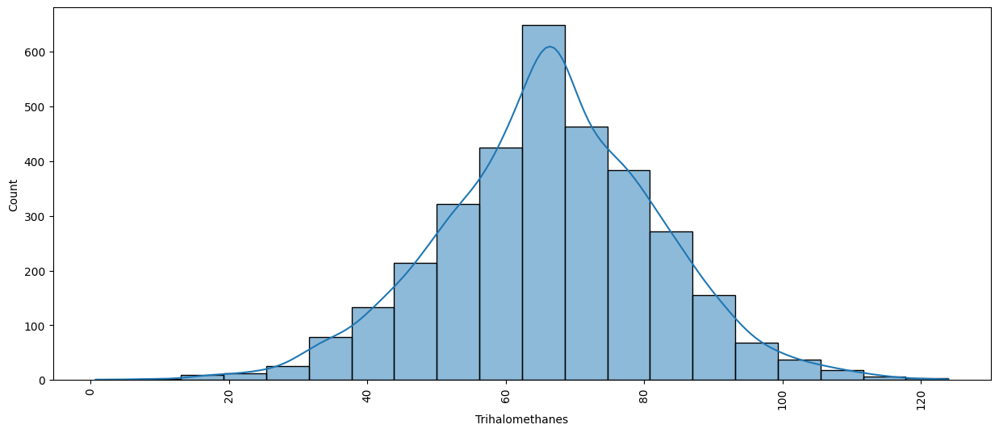

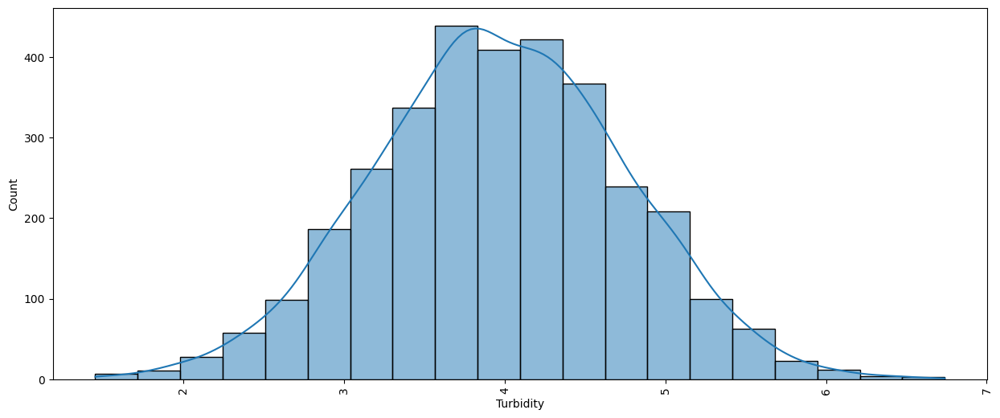

In [27]:
for i in continuous:
    plt.figure(figsize=(15,6))
    sns.histplot(df[i], bins = 20, kde = True, palette='hls')
    plt.xticks(rotation = 90)
    plt.show()

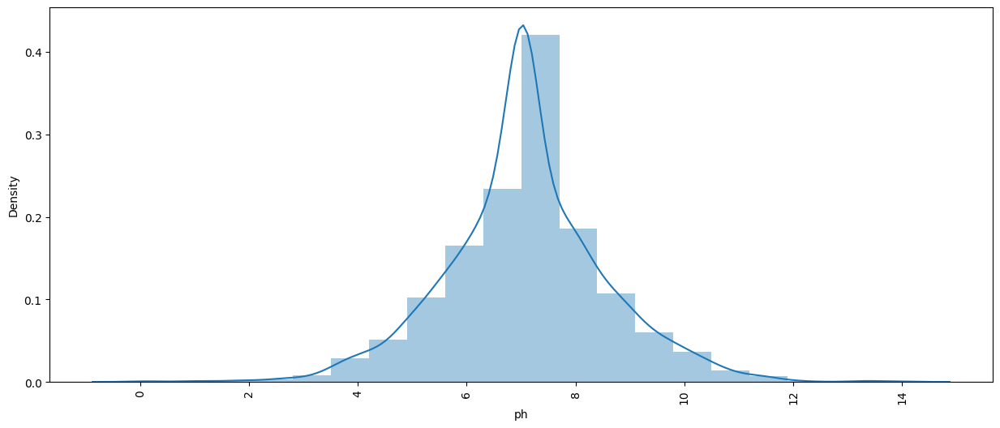

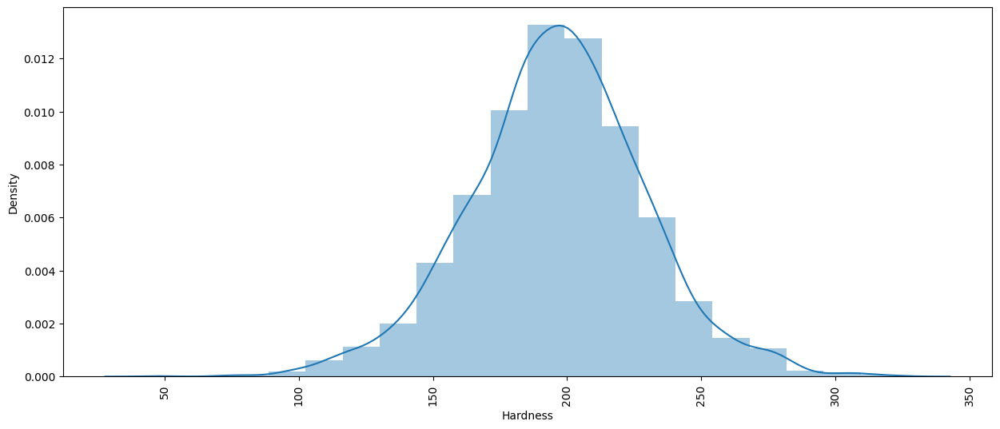

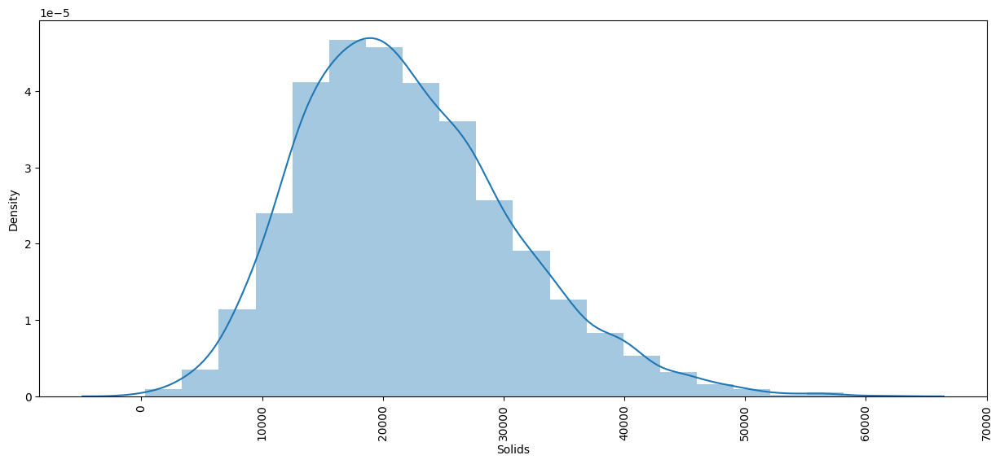

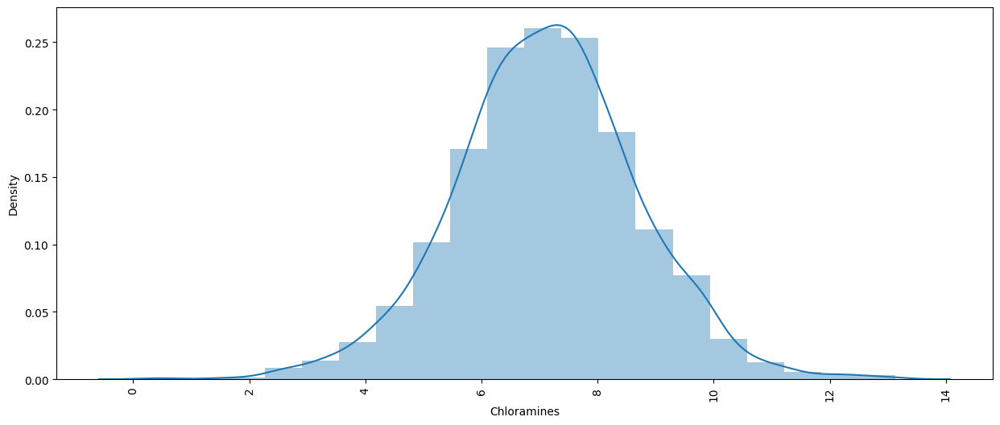

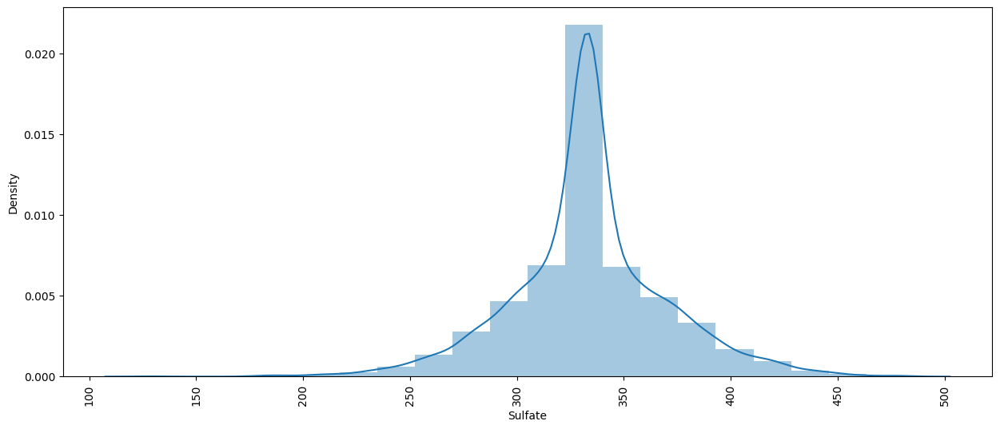

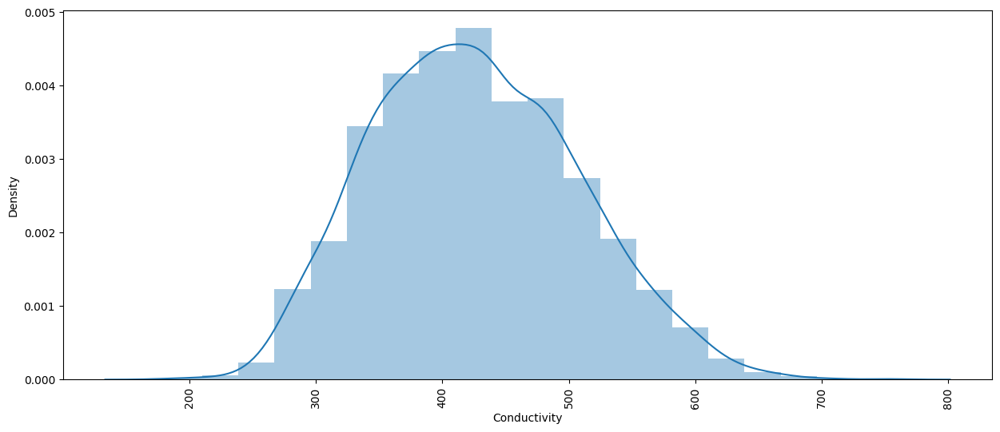

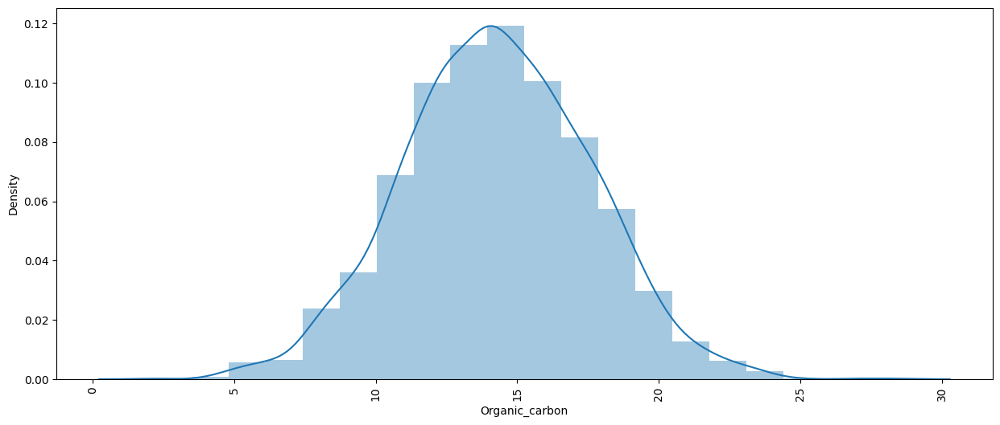

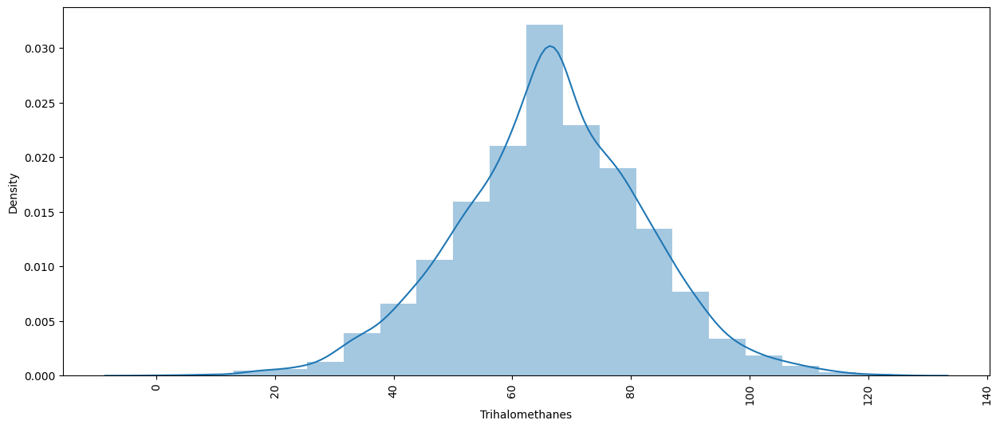

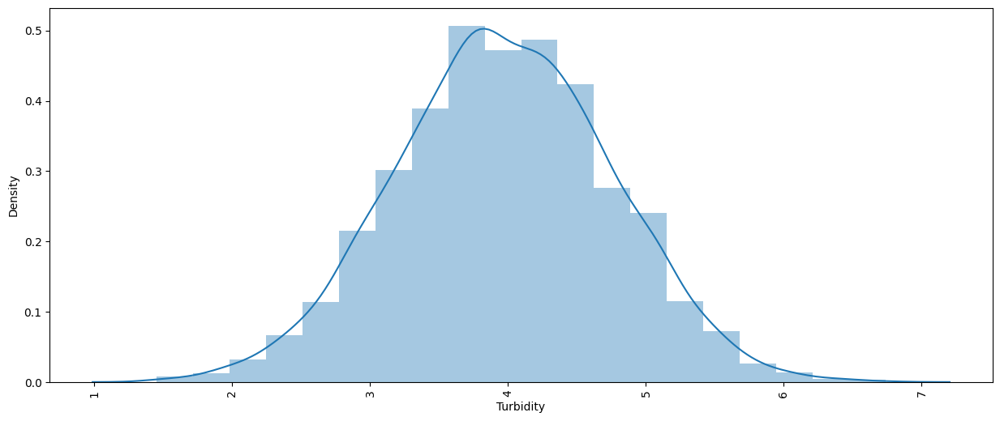

In [28]:
for i in continuous:
    plt.figure(figsize=(15,6))
    sns.distplot(df[i], bins = 20, kde = True)
    plt.xticks(rotation = 90)
    plt.show()

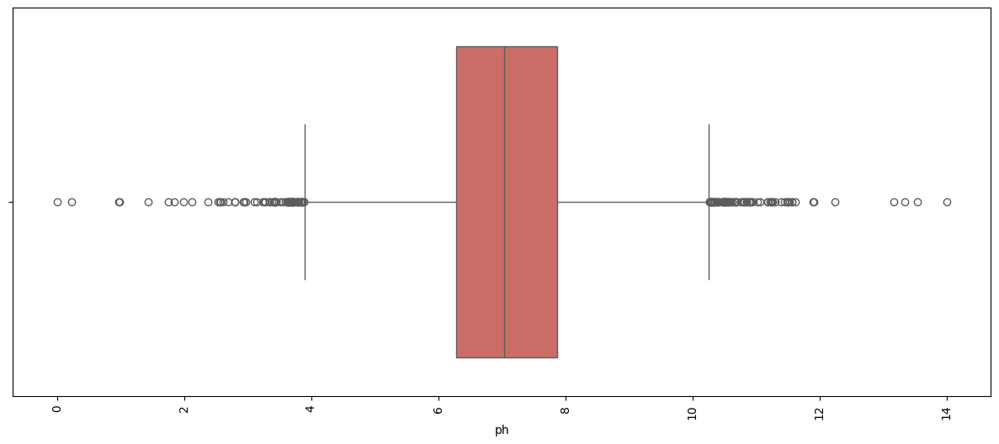

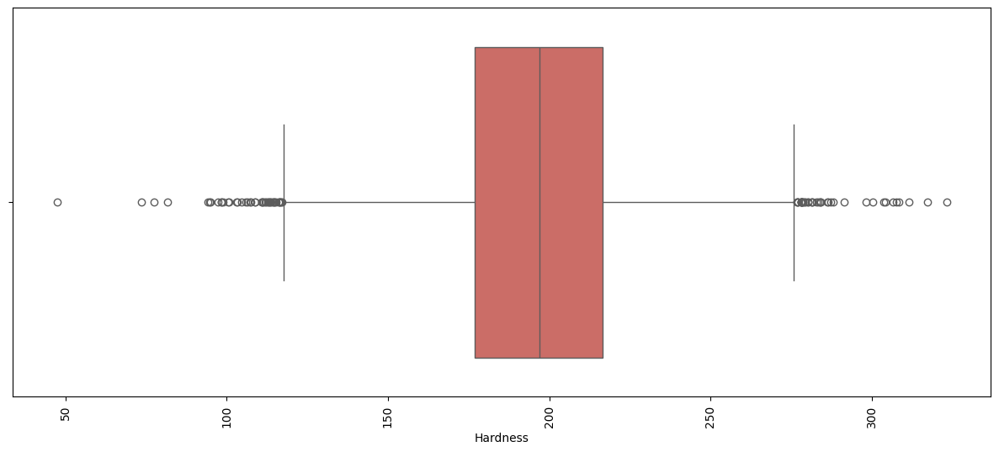

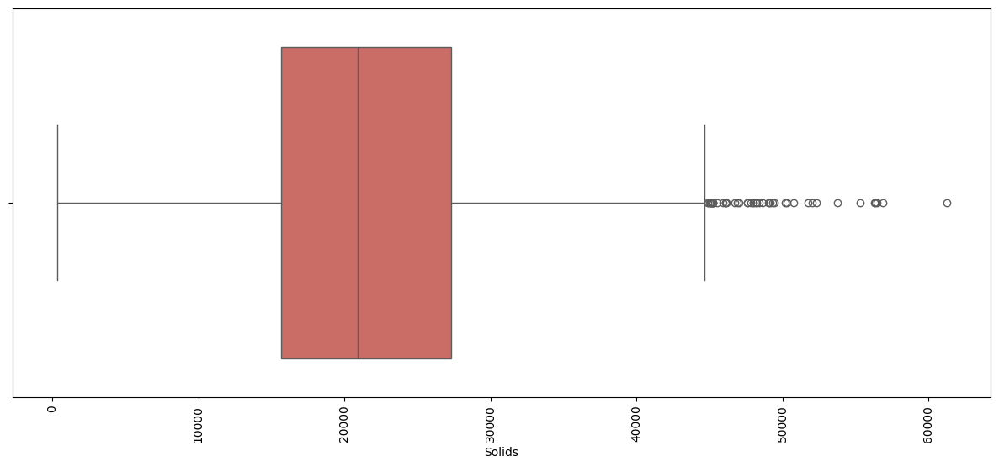

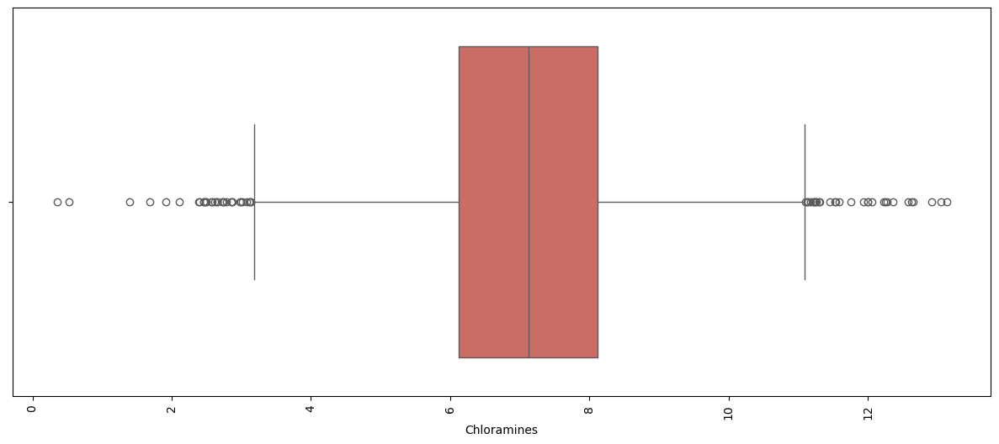

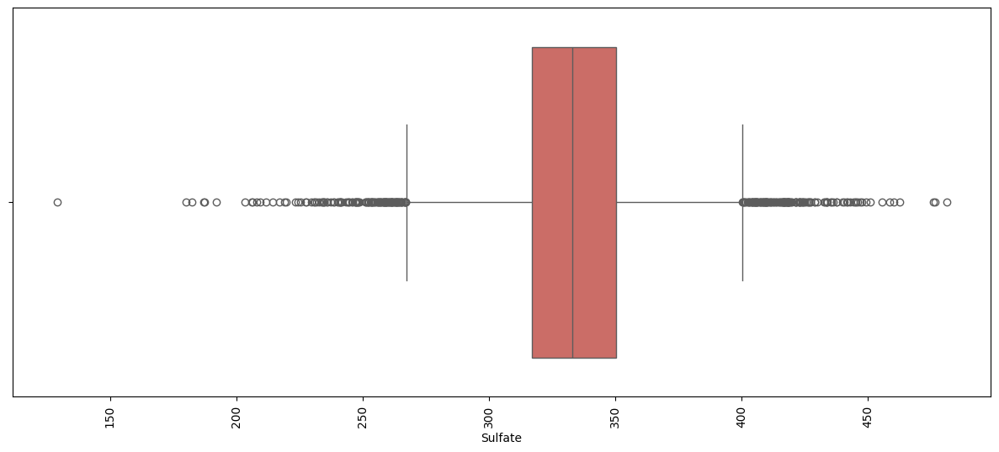

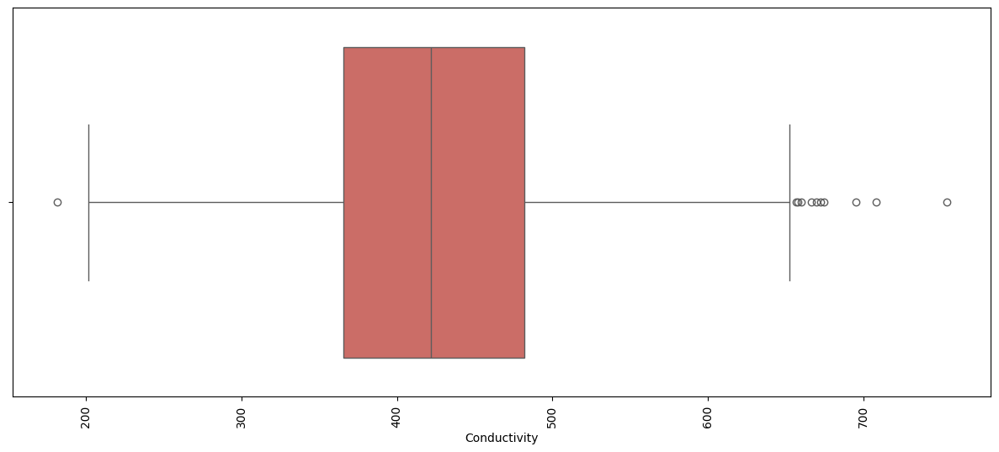

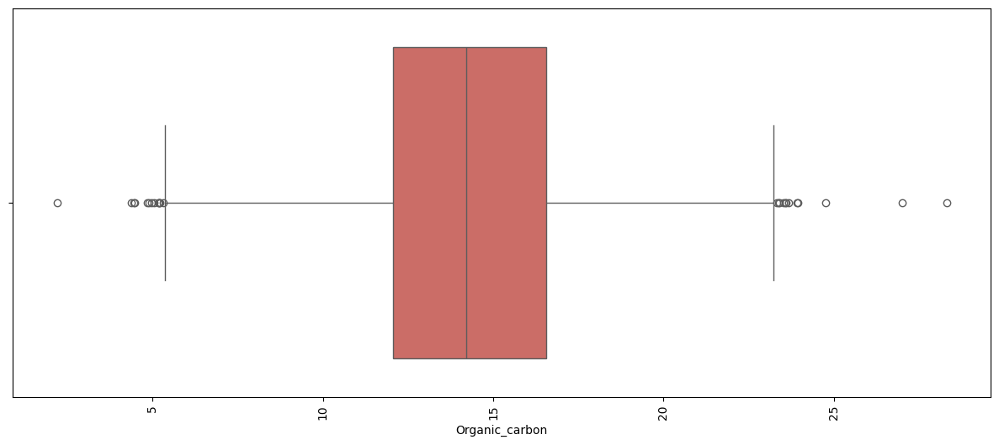

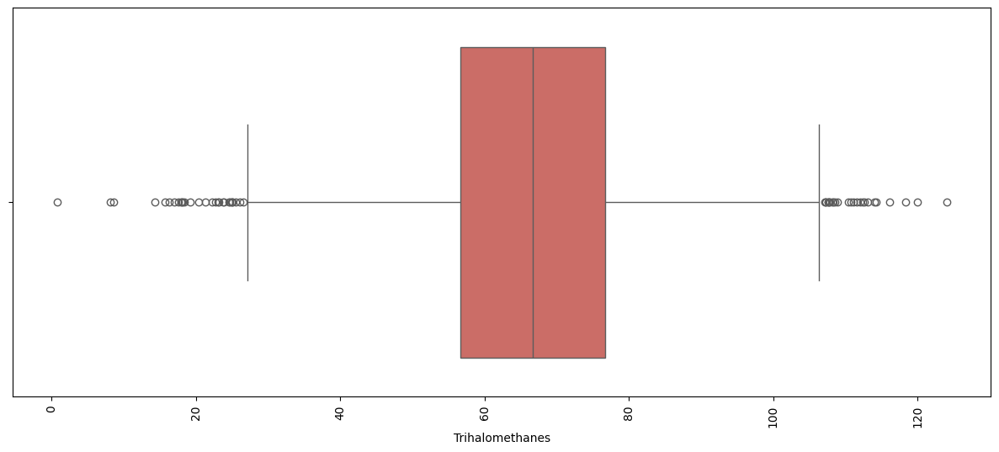

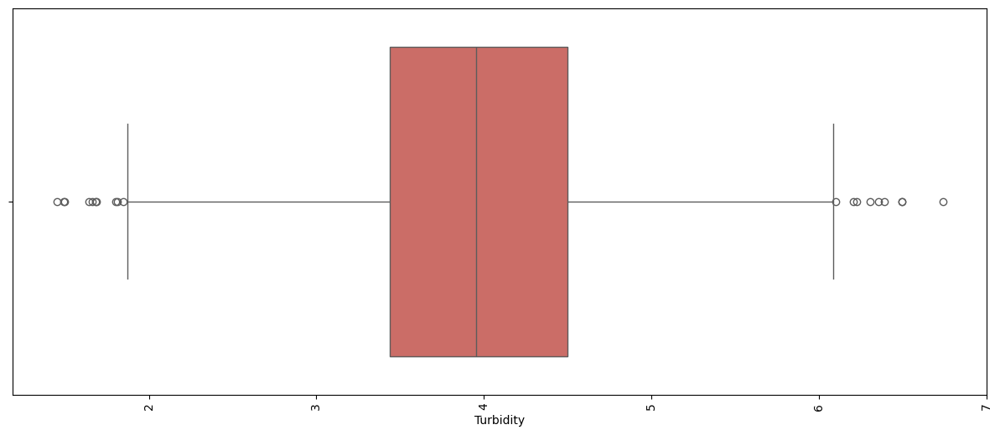

In [29]:
for i in continuous:
    plt.figure(figsize=(15, 6))
    sns.boxplot(x=i, data=df, palette='hls')
    plt.xticks(rotation=90)
    plt.show()

##bivariate analysis

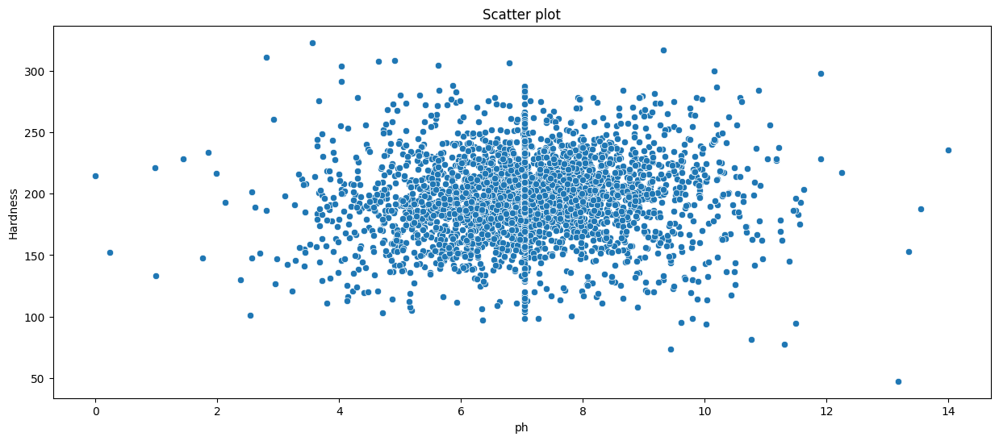

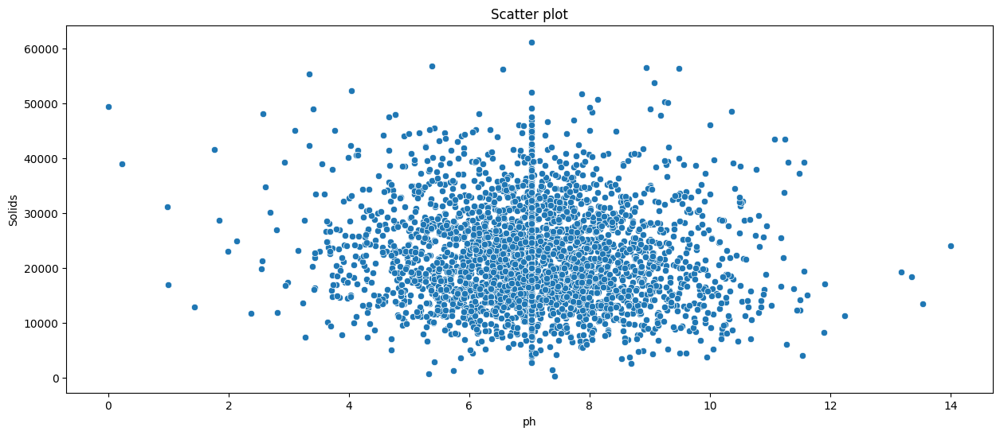

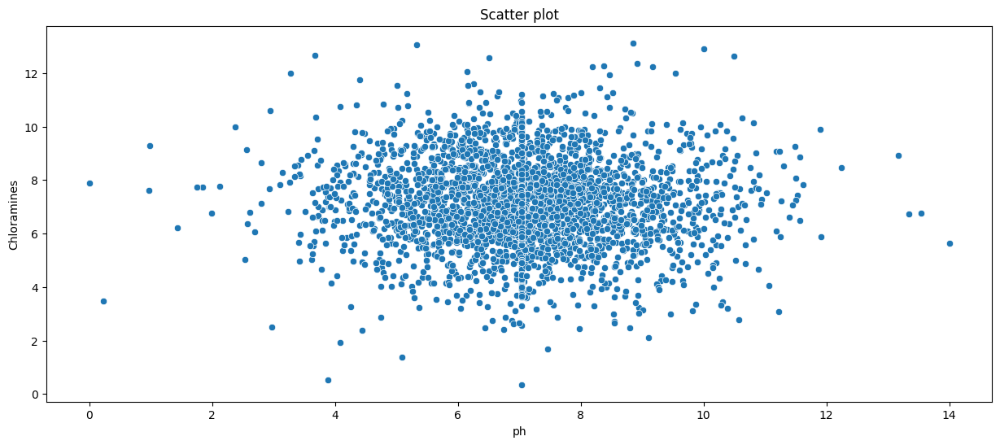

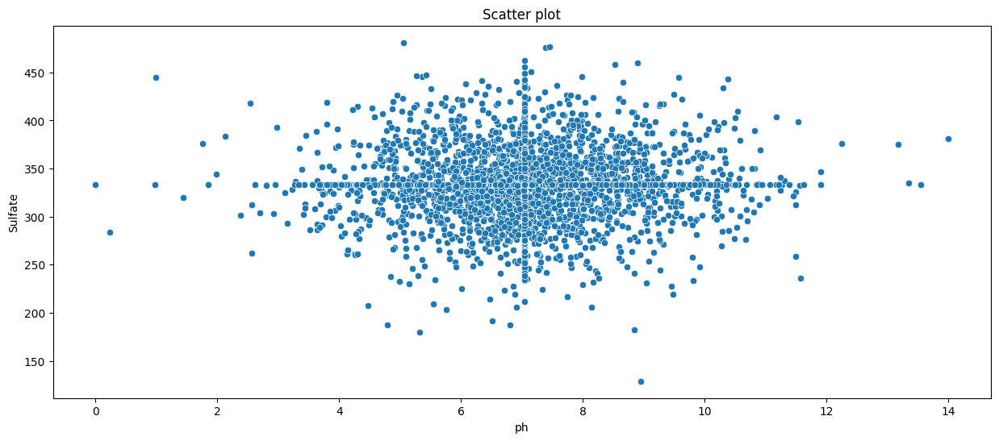

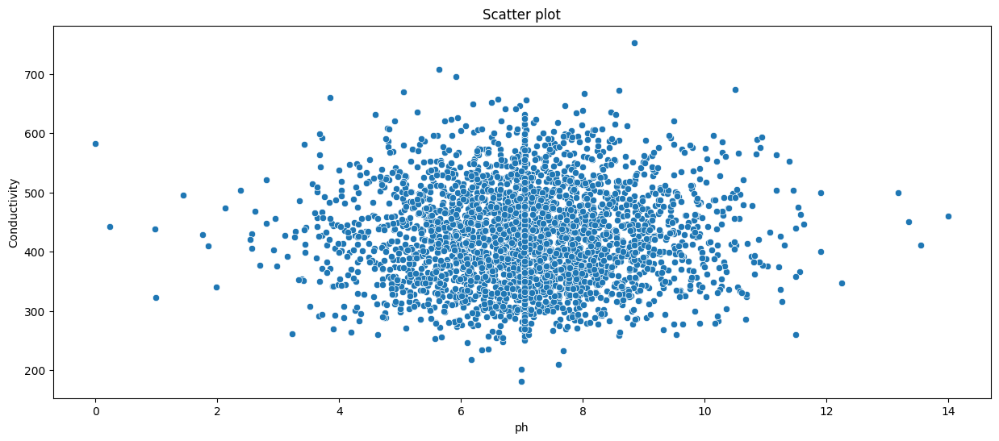

...

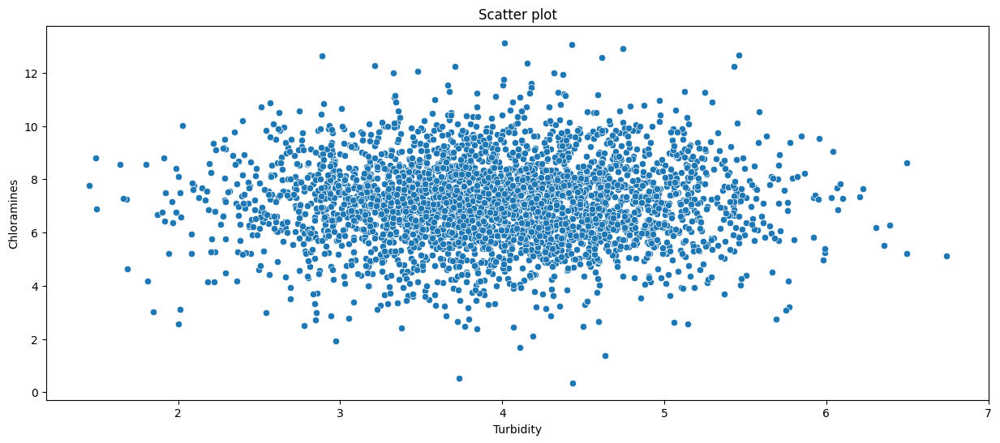

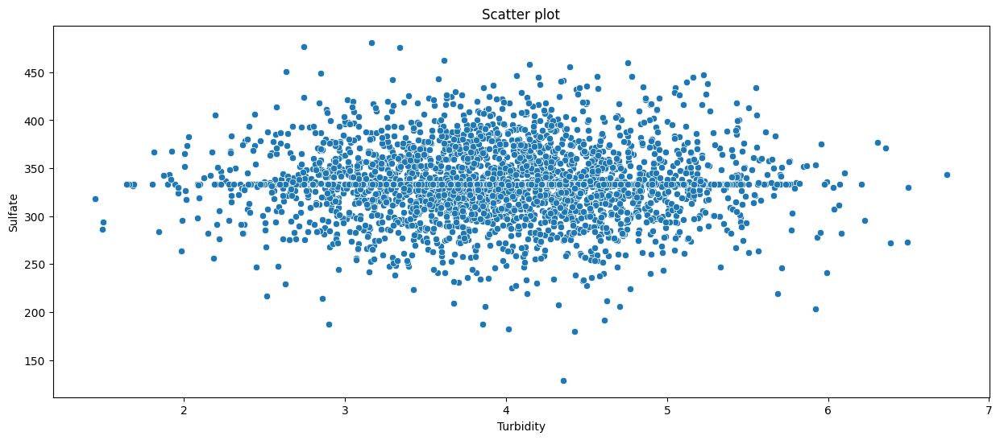

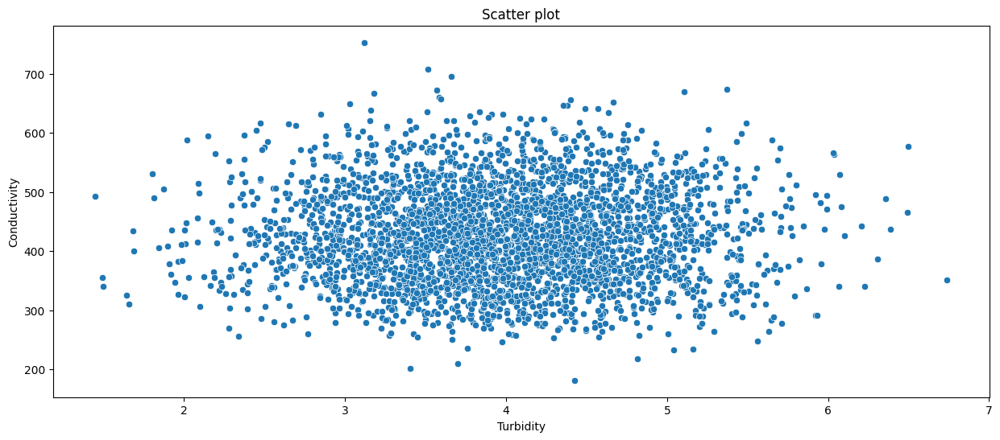

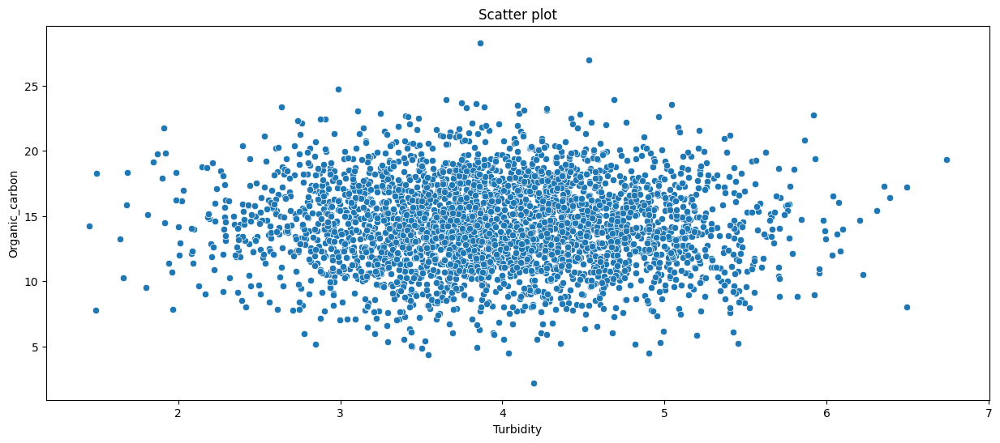

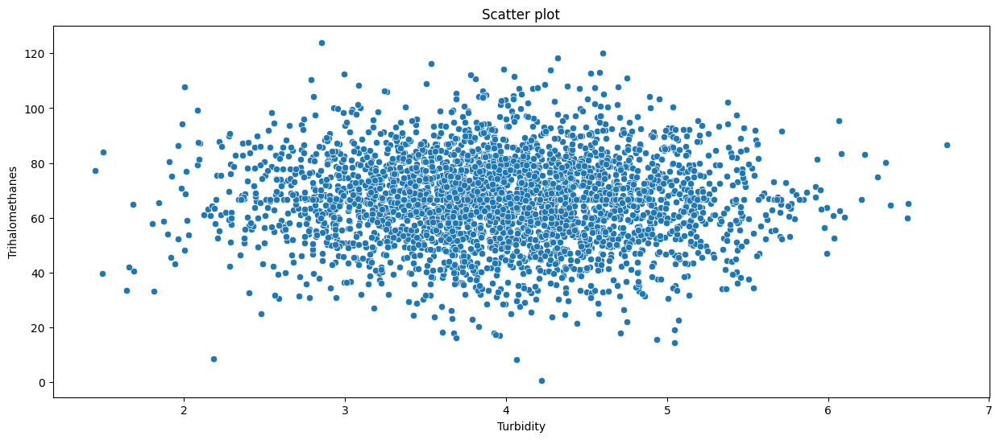

In [30]:
for i in continuous:
    for j in continuous:
        if i !=j:
            plt.figure(figsize=(15, 6))
            sns.scatterplot(x=i, y=j, data=df, palette='hls')
            plt.title(f'Scatter plot')
            plt.show()

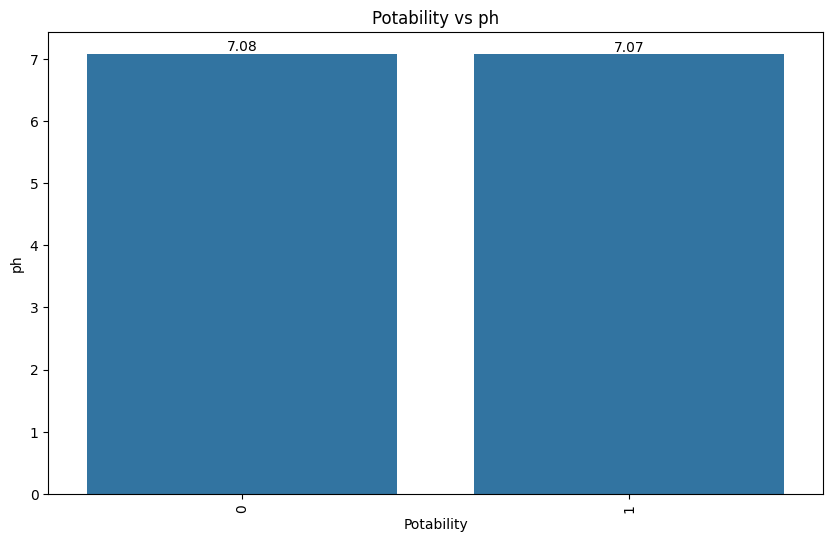

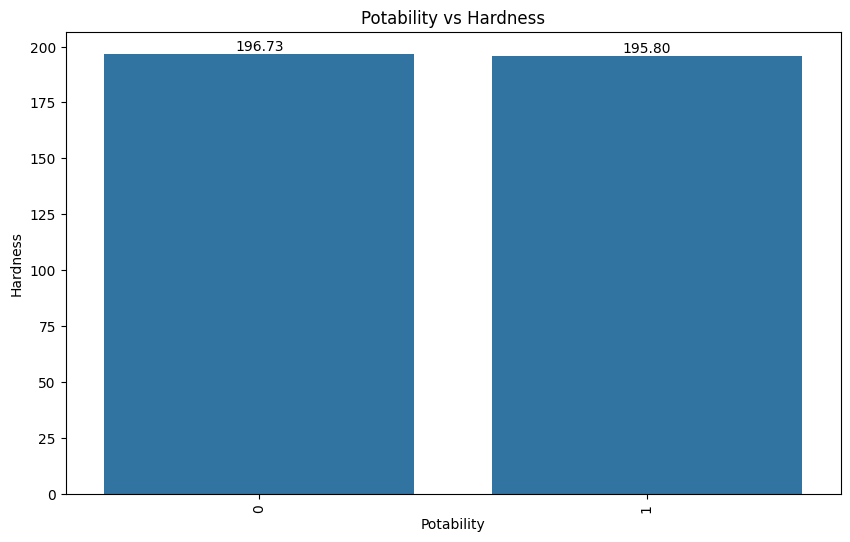

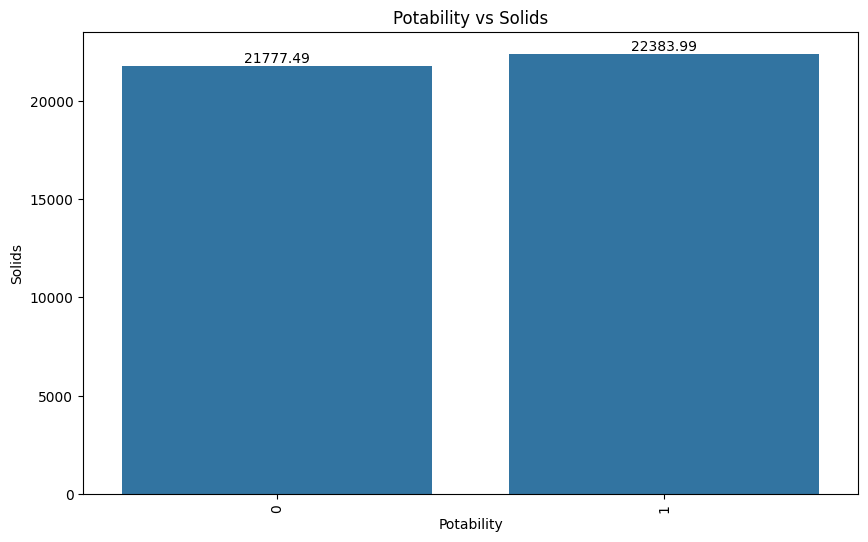

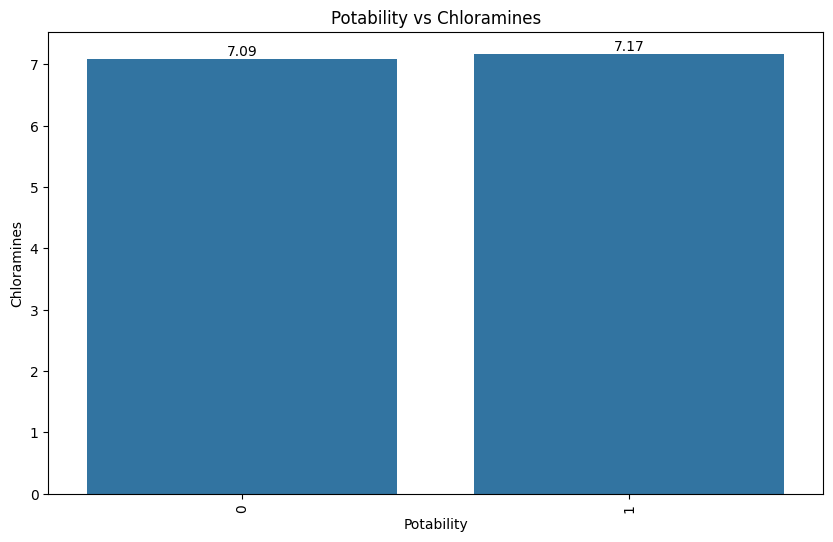

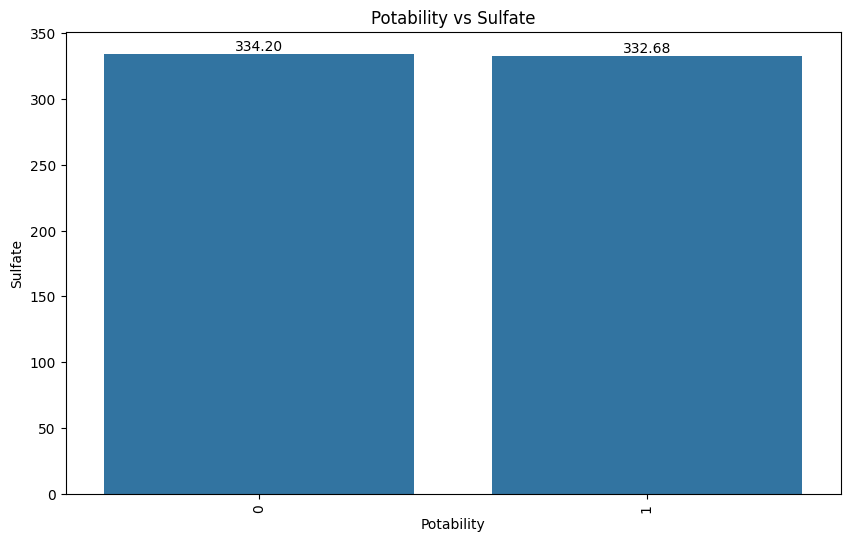

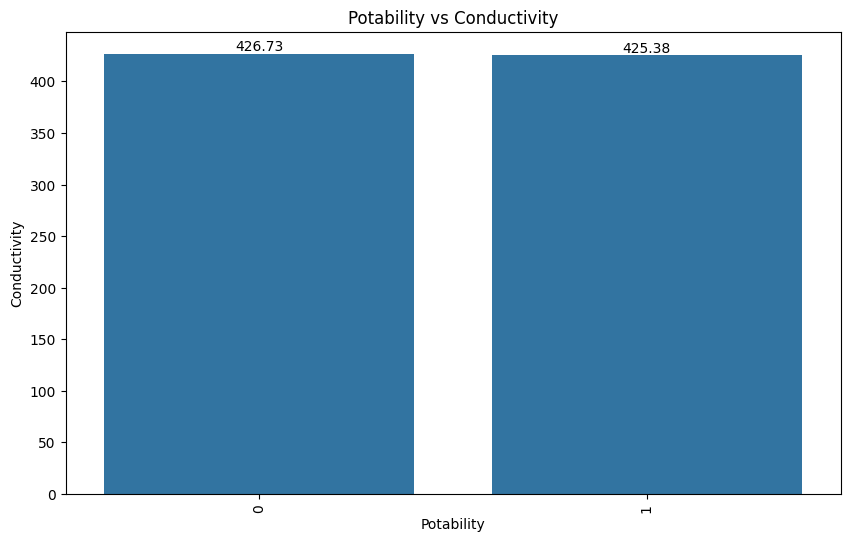

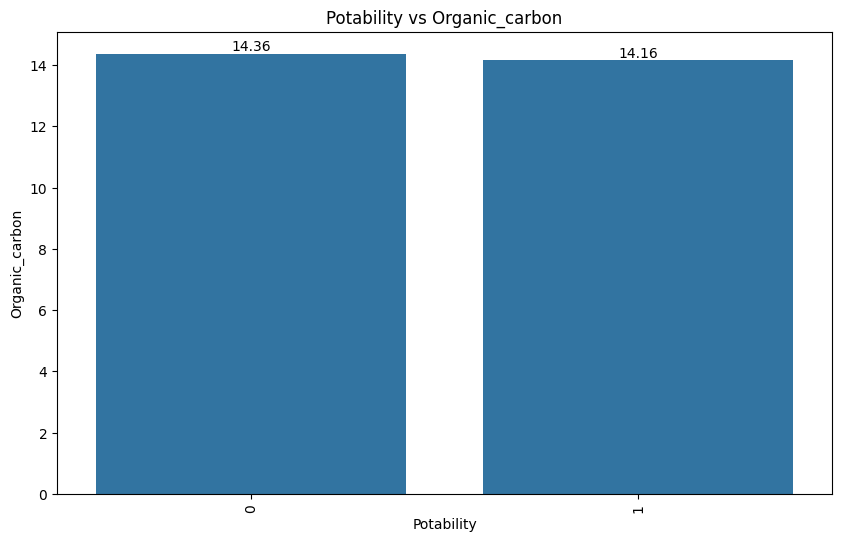

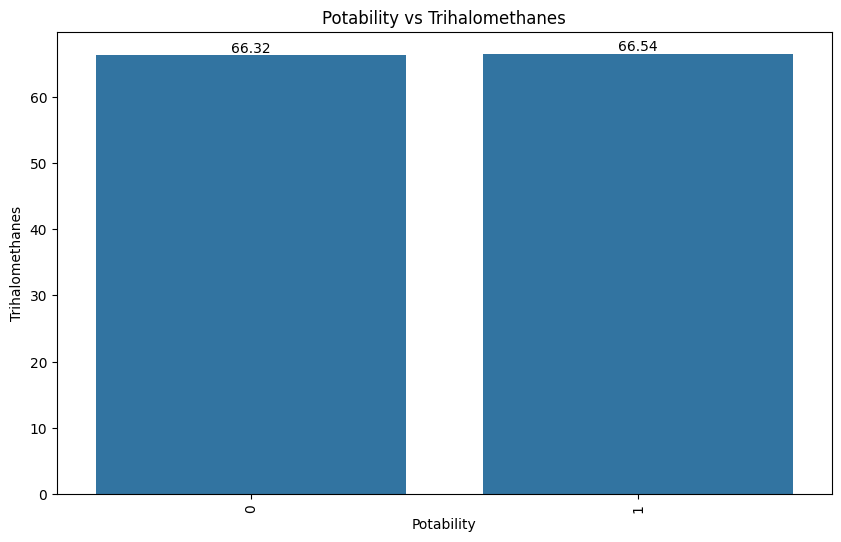

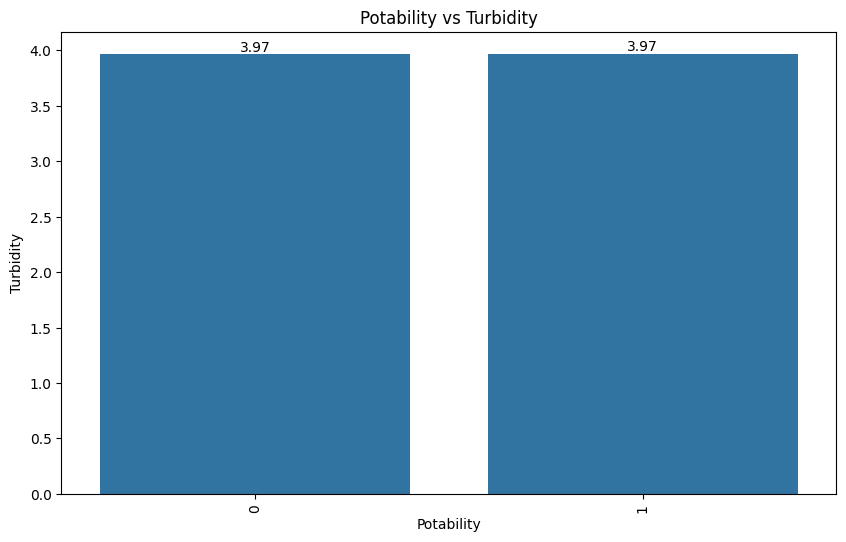

In [31]:
for cat in discrete:
    for cont in continuous:
        plt.figure(figsize=(10, 6))
        ax = sns.barplot(data=df, x=cat, y=cont, ci=None)
        plt.title(f'{cat} vs {cont}')

        for p in ax.patches:
            height = p.get_height()
            ax.annotate(f'{height:.2f}', (p.get_x() + p.get_width() / 2., height),
                        ha='center', va='bottom', fontsize=10, color='black', rotation=0)
        plt.xticks(rotation = 90)
        plt.show()

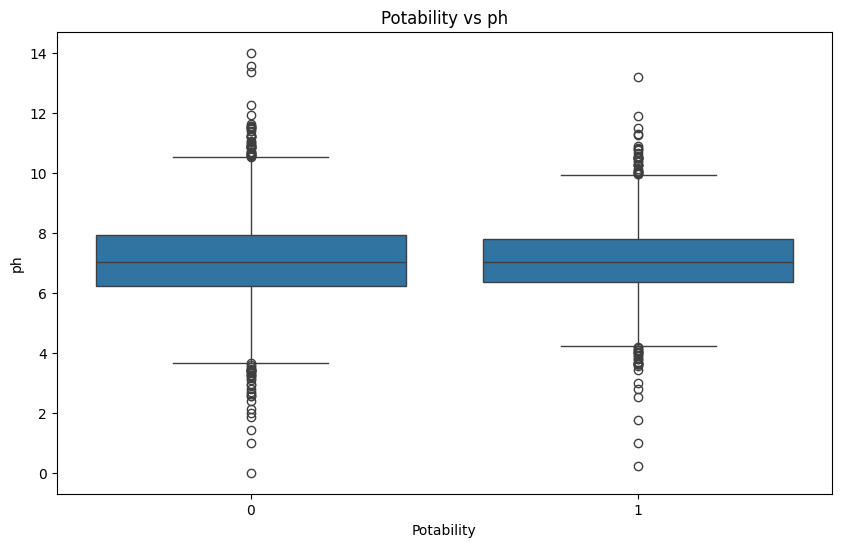

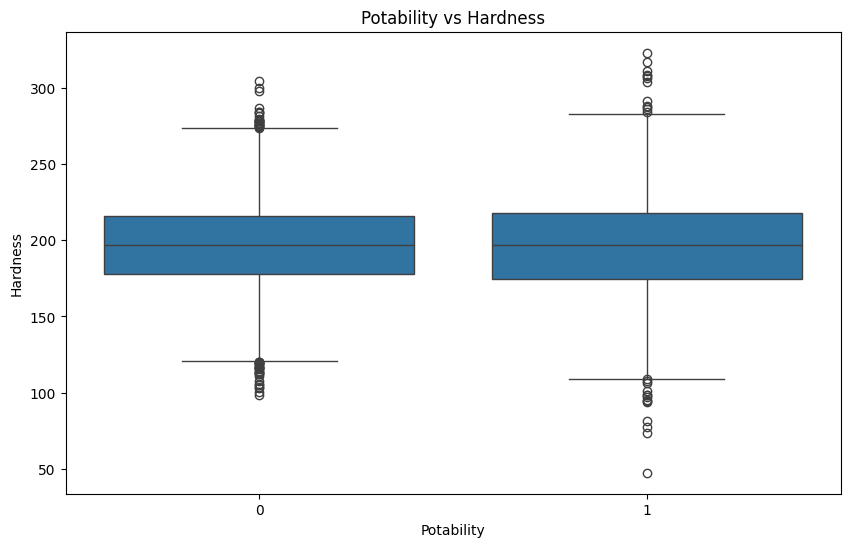

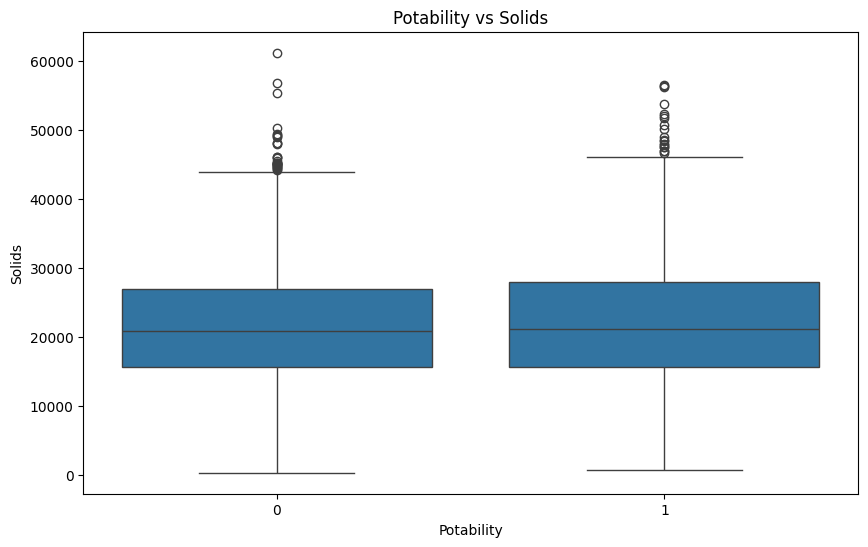

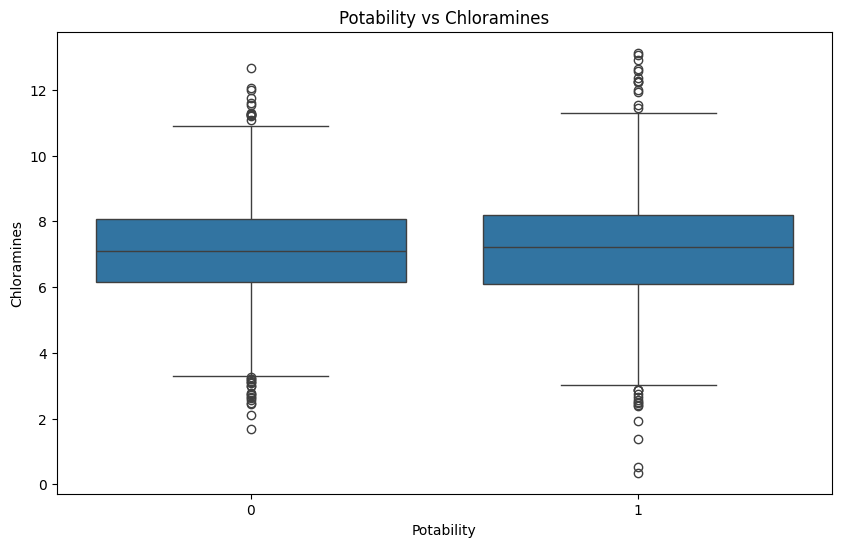

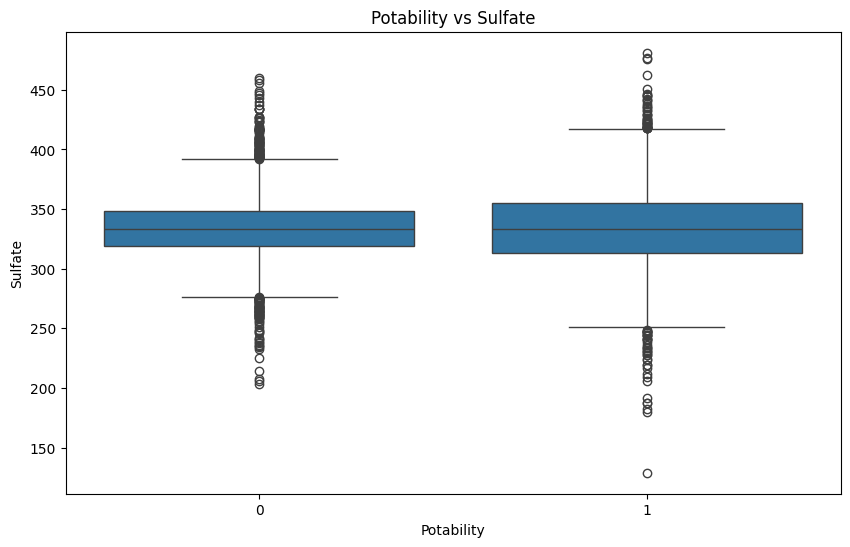

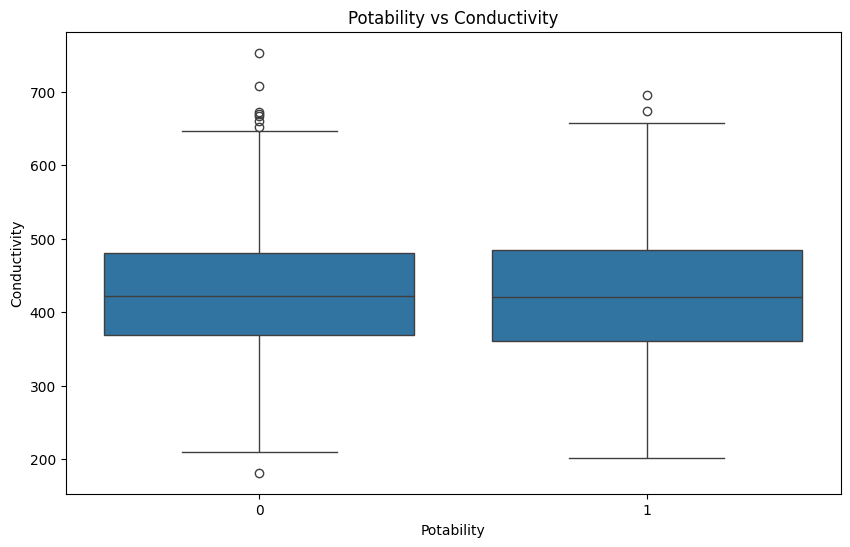

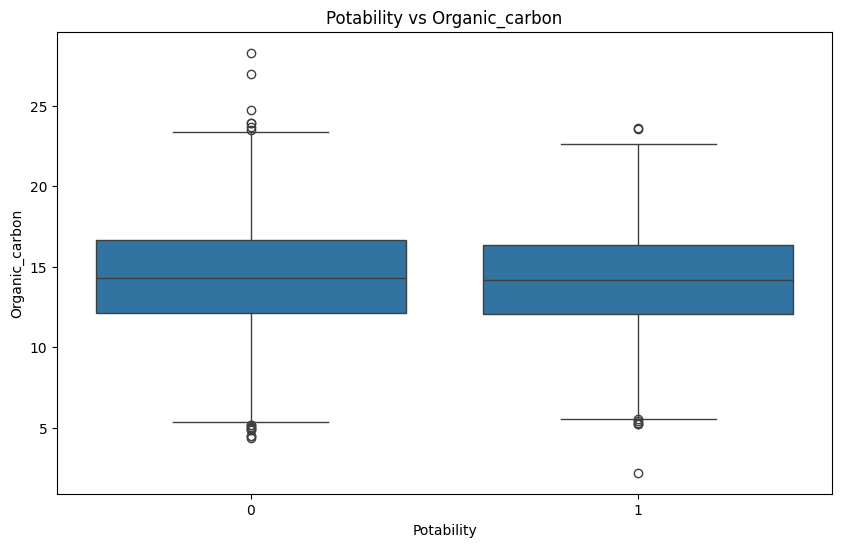

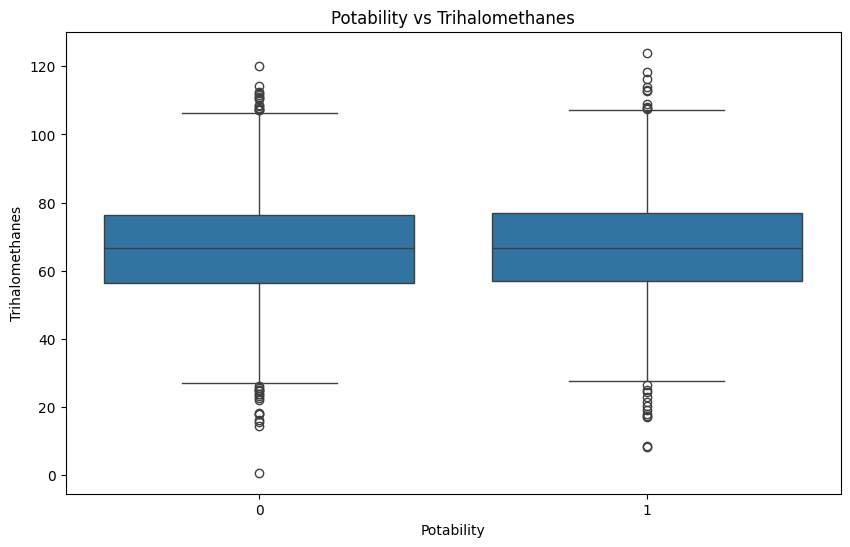

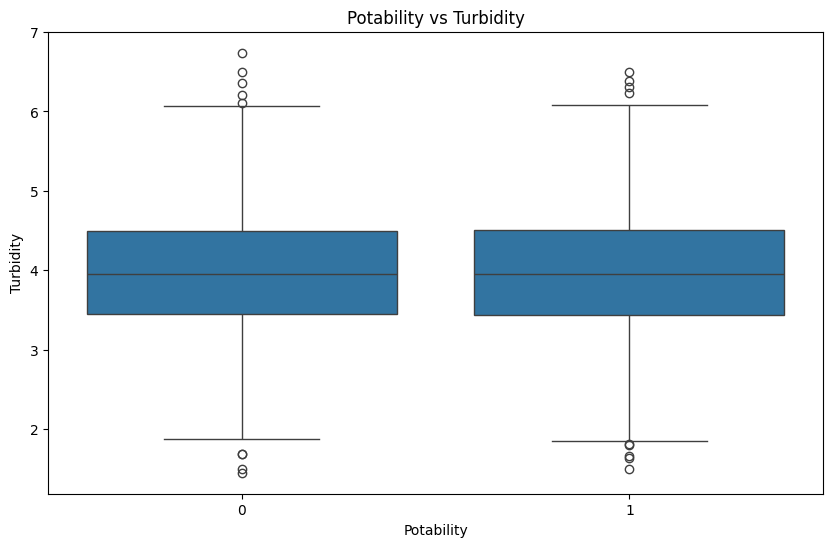

In [32]:
for cat in discrete:
    for cont in continuous:
        plt.figure(figsize=(10, 6))
        ax = sns.boxplot(data=df, x=cat, y=cont)
        plt.title(f'{cat} vs {cont}')


        plt.show()

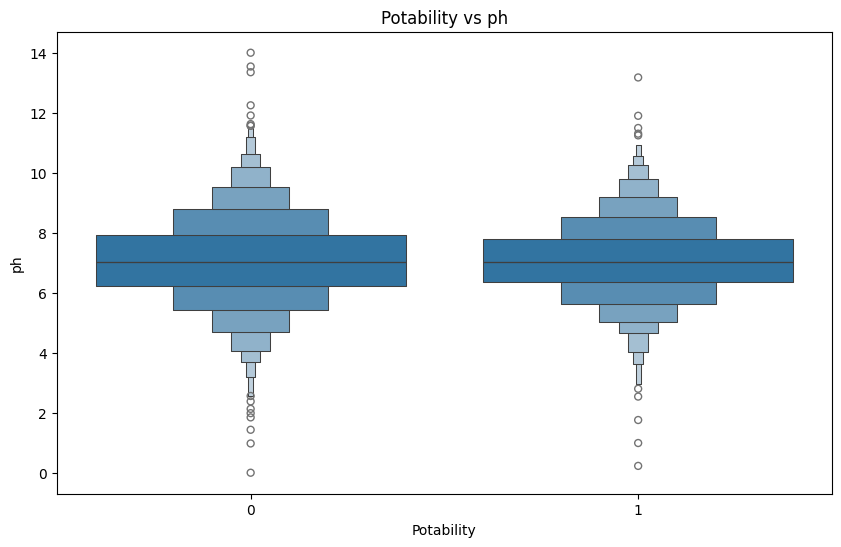

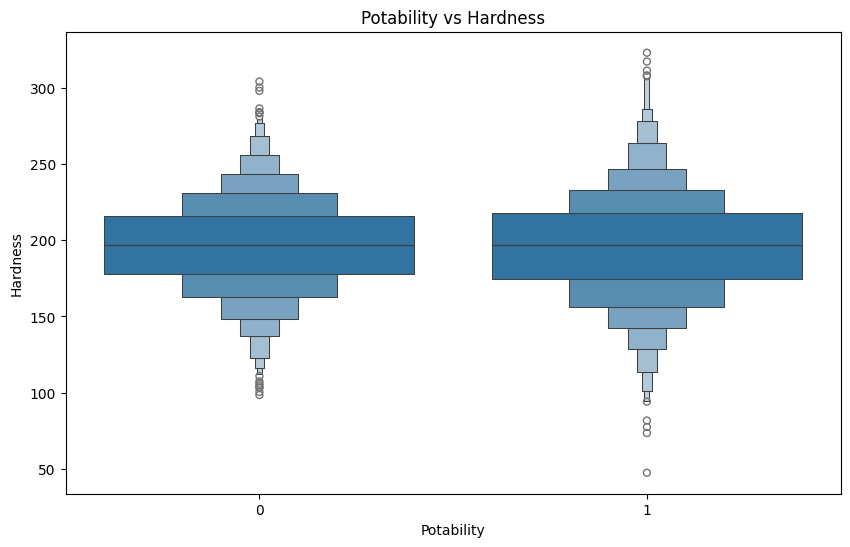

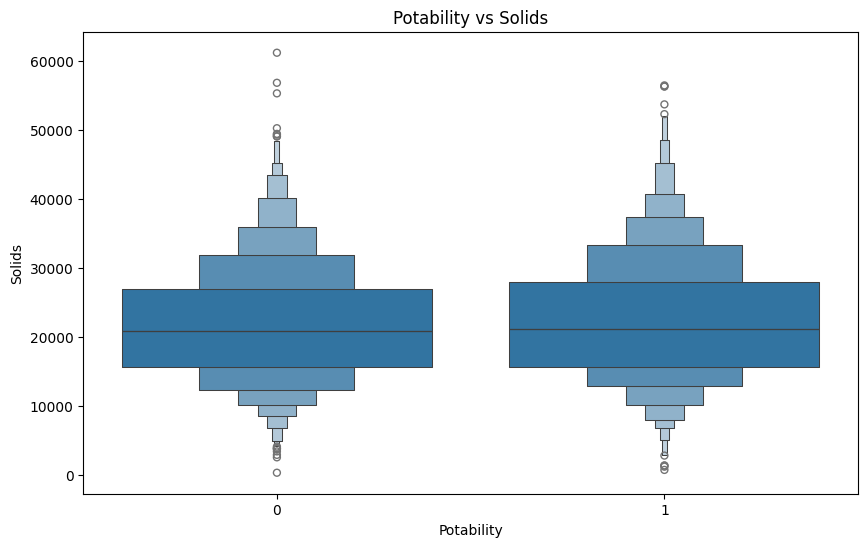

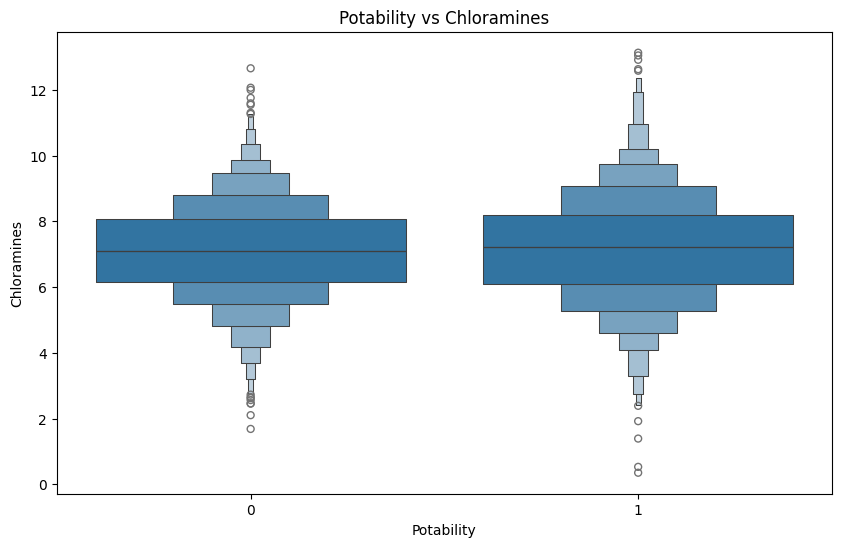

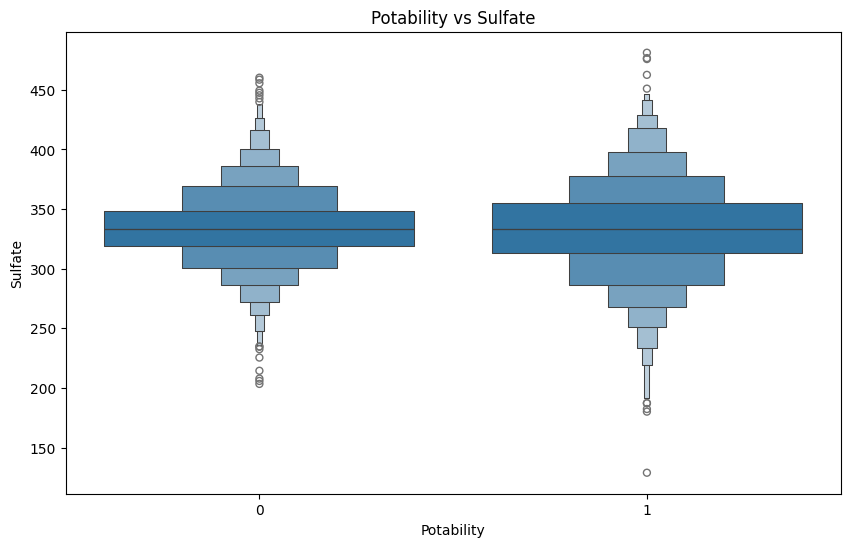

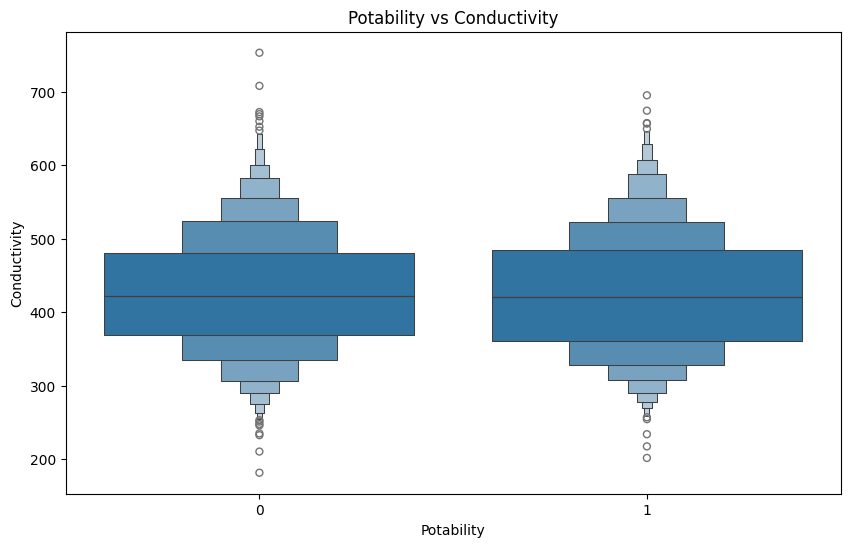

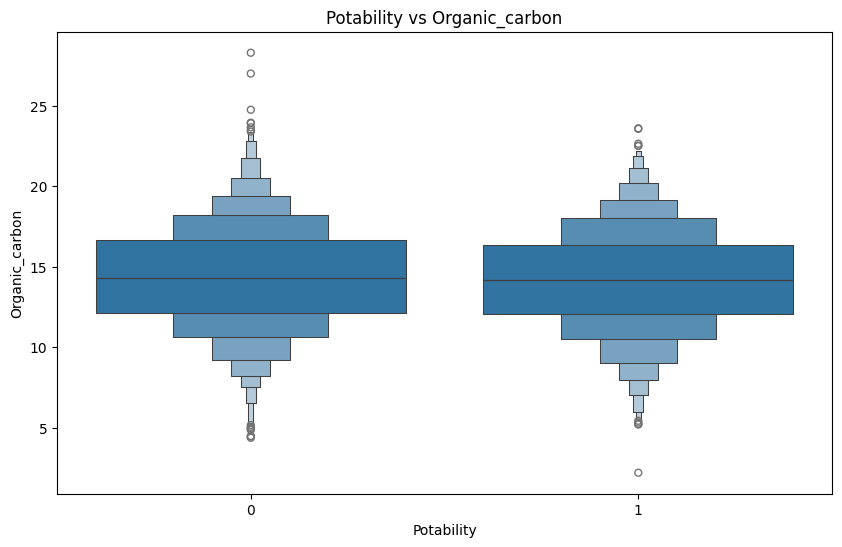

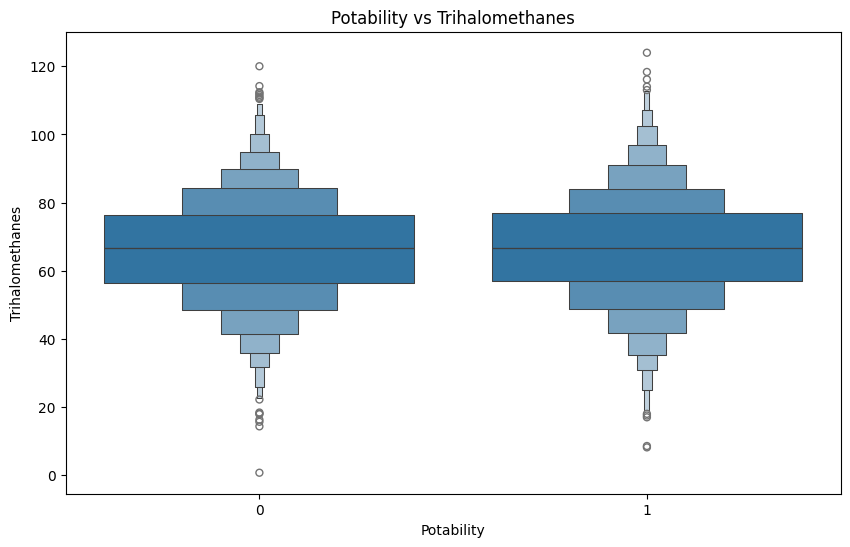

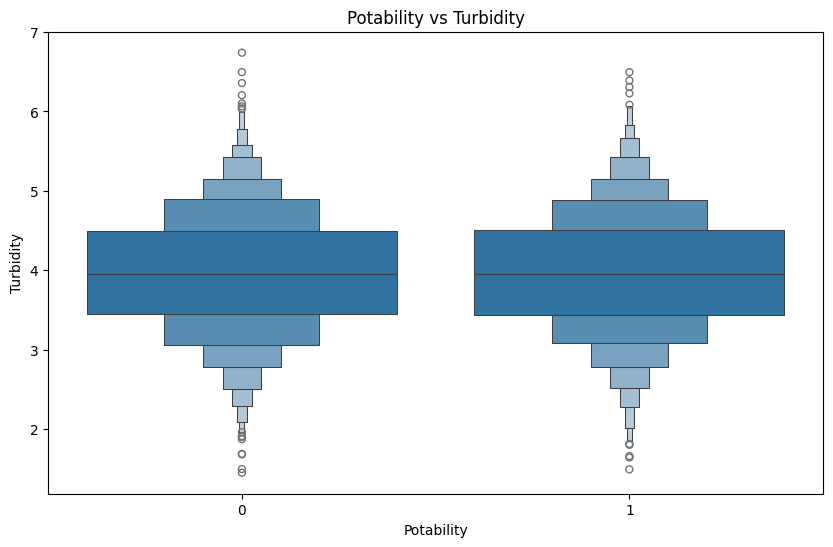

In [33]:
for cat in discrete:
    for cont in continuous:
        plt.figure(figsize=(10, 6))
        ax = sns.boxenplot(data=df, x=cat, y=cont)
        plt.title(f'{cat} vs {cont}')


        plt.show()

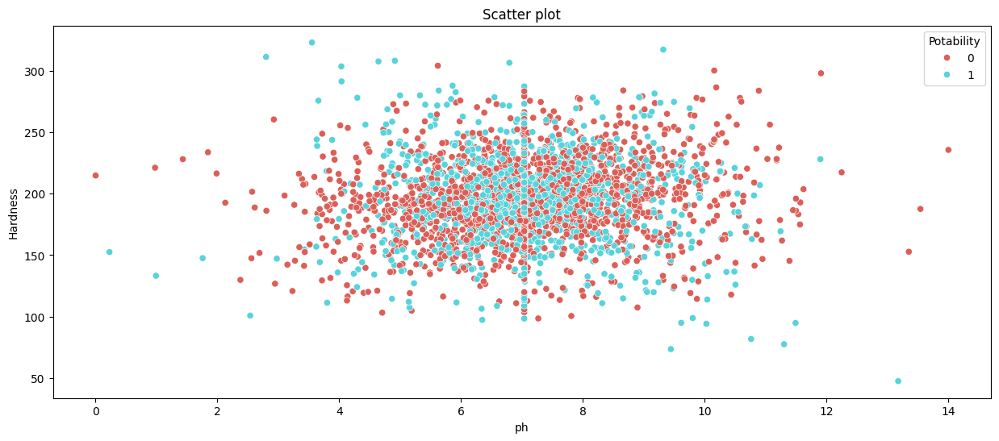

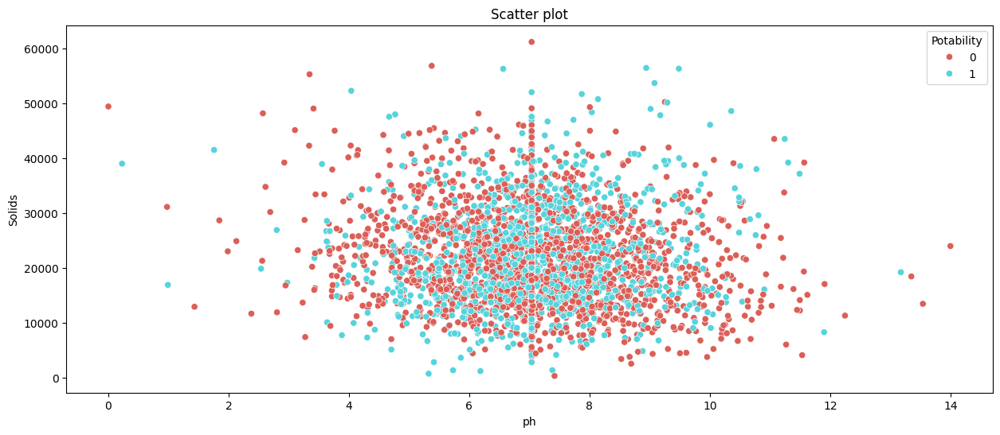

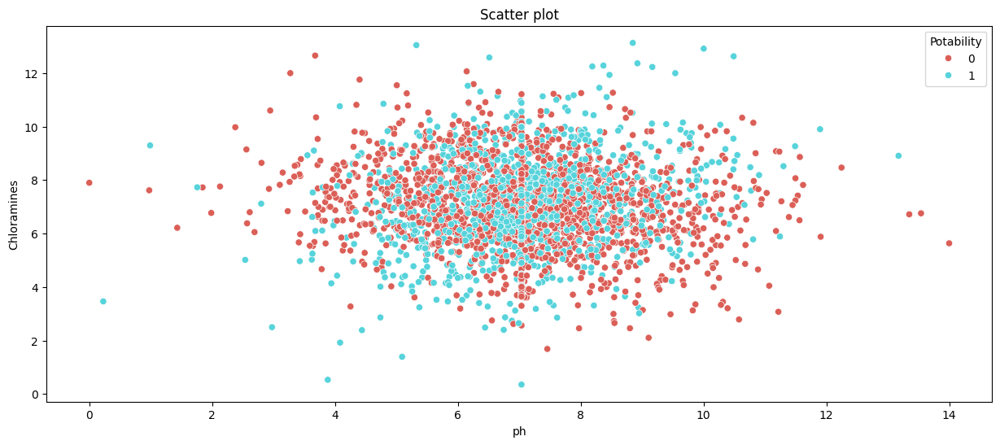

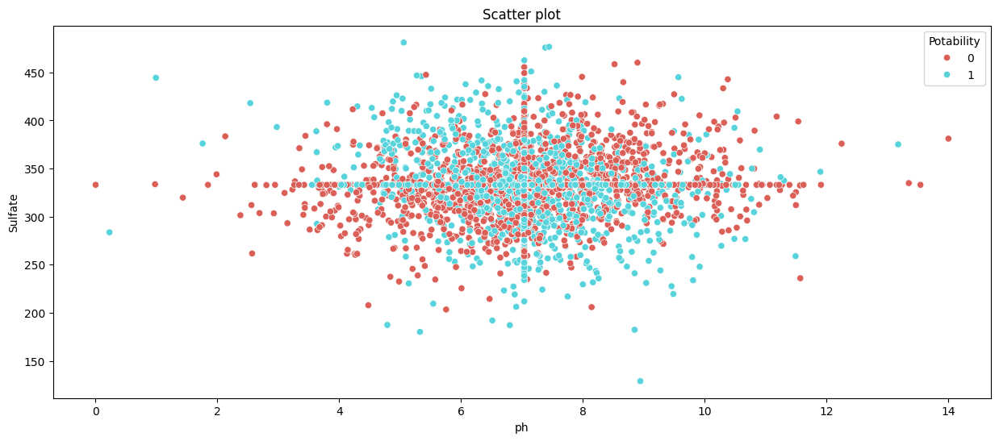

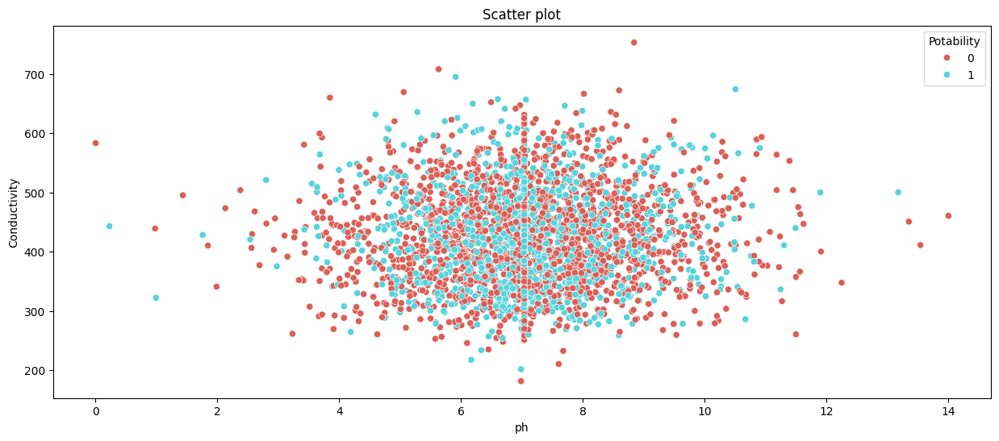

...

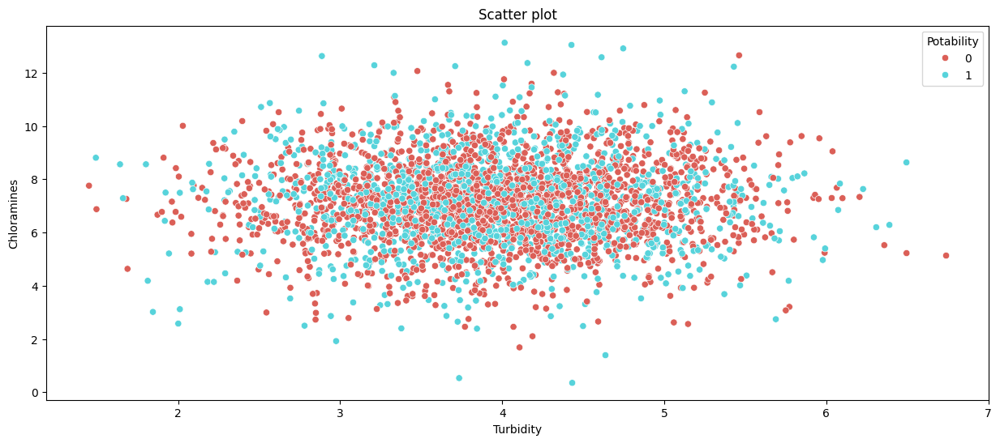

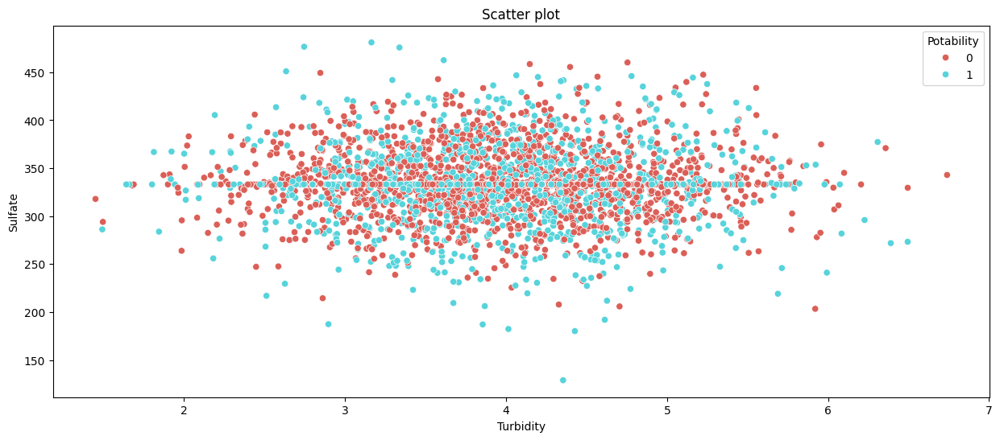

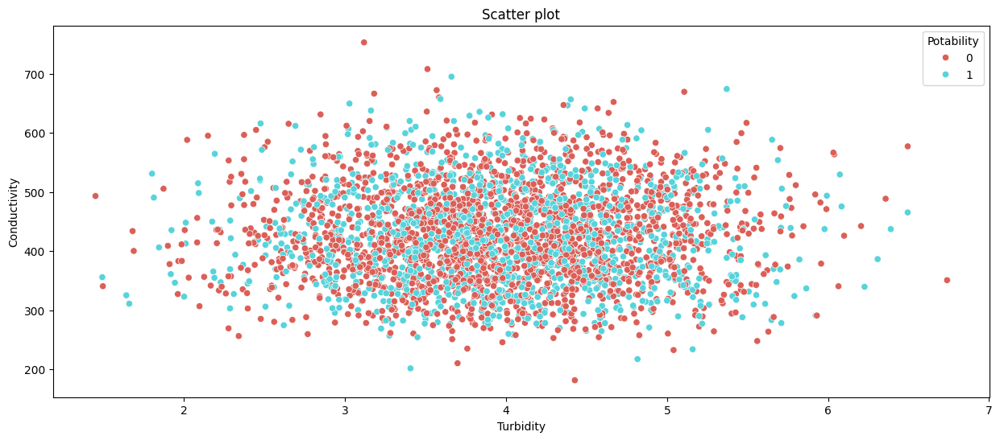

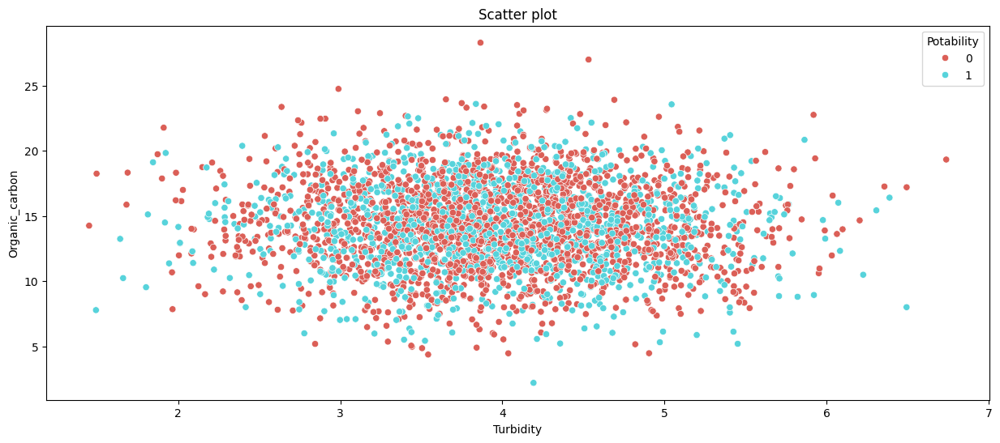

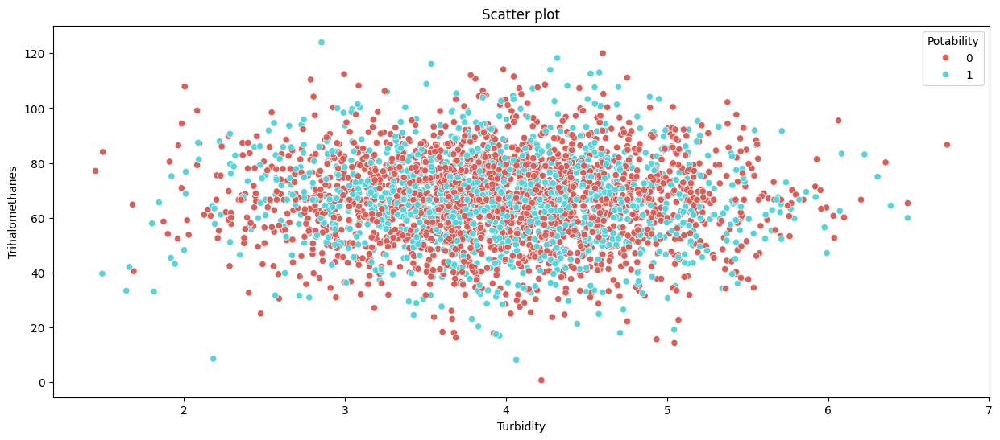

In [34]:
for i in continuous:
    for j in continuous:
        if i !=j:
            plt.figure(figsize=(15, 6))
            sns.scatterplot(x=i, y=j, data=df,hue='Potability', palette='hls')
            plt.title(f'Scatter plot')
            plt.show()

In [35]:
df.columns

Index(['ph', 'Hardness', 'Solids', 'Chloramines', 'Sulfate', 'Conductivity',
       'Organic_carbon', 'Trihalomethanes', 'Turbidity', 'Potability'],
      dtype='object')

In [36]:
df1 = df[['ph', 'Hardness', 'Solids', 'Chloramines', 'Sulfate', 'Conductivity','Organic_carbon', 'Trihalomethanes', 'Turbidity']]

In [37]:
Q1 = df1.quantile(0.25)
Q3 = df1.quantile(0.75)
IQR = Q3 - Q1

In [38]:
Q1


ph                     6.277673
Hardness             176.850538
Solids             15666.690300
Chloramines            6.127421
Sulfate              317.094638
Conductivity         365.734414
Organic_carbon        12.065801
Trihalomethanes       56.647656
Turbidity              3.439711
Name: 0.25, dtype: float64

In [39]:
  Q3

ph                     7.870050
Hardness             216.667456
Solids             27332.762125
Chloramines            8.114887
Sulfate              350.385756
Conductivity         481.792305
Organic_carbon        16.557652
Trihalomethanes       76.666609
Turbidity              4.500320
Name: 0.75, dtype: float64

In [40]:
  IQR

ph                     1.592377
Hardness              39.816918
Solids             11666.071825
Chloramines            1.987466
Sulfate               33.291119
Conductivity         116.057890
Organic_carbon         4.491850
Trihalomethanes       20.018954
Turbidity              1.060609
dtype: float64

In [41]:
  X = Q1 - 1.5 * IQR
  Y = Q3 + 1.5 * IQR

In [42]:
X

ph                    3.889107
Hardness            117.125160
Solids            -1832.417437
Chloramines           3.146221
Sulfate             267.157960
Conductivity        191.647579
Organic_carbon        5.328026
Trihalomethanes      26.619225
Turbidity             1.848797
dtype: float64

In [43]:
Y

ph                    10.258615
Hardness             276.392834
Solids             44831.869862
Chloramines           11.096086
Sulfate              400.322434
Conductivity         655.879140
Organic_carbon        23.295427
Trihalomethanes      106.695040
Turbidity              6.091233
dtype: float64

In [44]:
df2 = df[~((df1 < (Q1 - 1.5 * IQR)) | (df1 > (Q3 + 1.5 * IQR))).any(axis = 1)]

In [45]:
df2

,ph,Hardness,Solids,Chloramines,Sulfate,Conductivity,Organic_carbon,Trihalomethanes,Turbidity,Potability
0,7.036752,204.890456,20791.31898,7.300212,368.516441,564.308654,10.379783,86.990970,2.963135,0
2,8.099124,224.236259,19909.54173,9.275884,333.073546,418.606213,16.868637,66.420093,3.055934,0
3,8.316766,214.373394,22018.41744,8.059332,356.886136,363.266516,18.436525,100.341674,4.628771,0
4,9.092223,181.101509,17978.98634,6.546600,310.135738,398.410813,11.558279,31.997993,4.075075,0
5,5.584087,188.313324,28748.68774,7.544869,326.678363,280.467916,8.399735,54.917862,2.559708,0
...,...,...,...,...,...,...,...,...,...,...
3270,6.069616,186.659040,26138.78019,7.747547,345.700257,415.886955,12.067620,60.419921,3.669712,1
3272,7.808856,193.553212,17329.80216,8.061362,333.073546,392.449580,19.903225,66.622485,2.798243,1
3273,9.419510,175.762646,33155.57822,7.350233,333.073546,432.044783,11.039070,69.845400,3.298875,1
3274,5.126763,230.603758,11983.86938,6.303357,333.073546,402.883113,11.168946,77.488213,4.708658,1


In [46]:
corr = df2.corr()

In [47]:
corr

,ph,Hardness,Solids,Chloramines,Sulfate,Conductivity,Organic_carbon,Trihalomethanes,Turbidity,Potability
ph,1.000000,0.131282,-0.086986,-0.062773,0.016465,0.002192,0.026461,0.009309,-0.042813,-0.005499
Hardness,0.131282,1.000000,-0.045552,-0.035832,-0.027797,-0.030415,0.012463,-0.007059,-0.022362,-0.000710
Solids,-0.086986,-0.045552,1.000000,-0.040392,-0.109980,0.007087,0.026793,-0.024442,0.022801,0.005600
Chloramines,-0.062773,-0.035832,-0.040392,1.000000,0.024519,-0.015277,-0.000684,0.016538,-0.005415,0.013195
Sulfate,0.016465,-0.027797,-0.109980,0.024519,1.000000,-0.005927,-0.007304,-0.022391,-0.017396,-0.003876
Conductivity,0.002192,-0.030415,0.007087,-0.015277,-0.005927,1.000000,0.006515,-0.001196,0.007674,-0.001886
Organic_carbon,0.026461,0.012463,0.026793,-0.000684,-0.007304,0.006515,1.000000,-0.000050,-0.016705,-0.027090
Trihalomethanes,0.009309,-0.007059,-0.024442,0.016538,-0.022391,-0.001196,-0.000050,1.000000,-0.024258,0.014274
Turbidity,-0.042813,-0.022362,0.022801,-0.005415,-0.017396,0.007674,-0.016705,-0.024258,1.000000,0.004761
Potability,-0.005499,-0.000710,0.005600,0.013195,-0.003876,-0.001886,-0.027090,0.014274,0.004761,1.000000


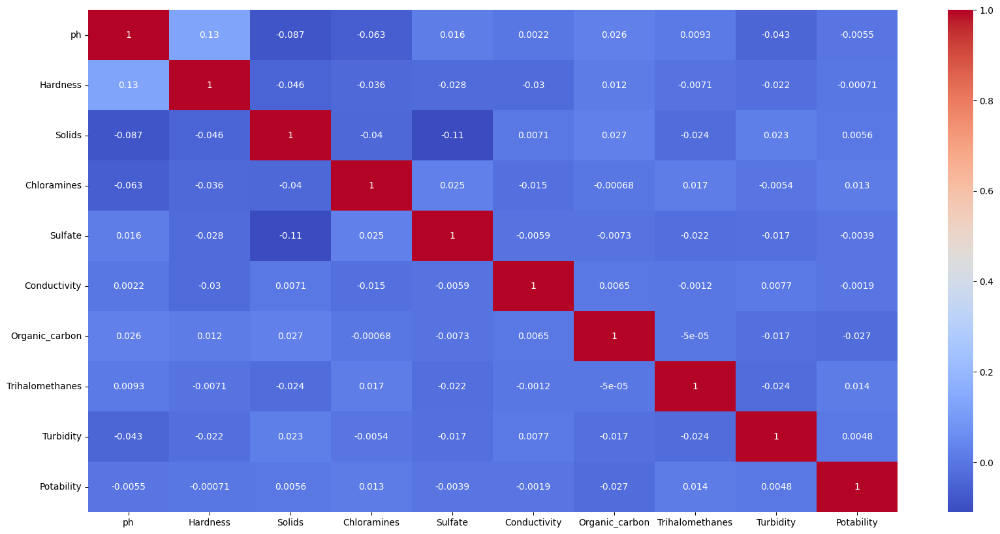

In [48]:
plt.figure(figsize=(20,10))
sns.heatmap(corr, annot=True, cmap='coolwarm')
plt.show()

In [49]:
categorical, non_categorical, discrete, continuous = classify_features(df2)

In [50]:
print("Categorical Features:", categorical)
print("Non-Categorical Features:", non_categorical)
print("Discrete Features:", discrete)
print("Continuous Features:", continuous)

Categorical Features: []
Non-Categorical Features: []
Discrete Features: ['Potability']
Continuous Features: ['ph', 'Hardness', 'Solids', 'Chloramines', 'Sulfate', 'Conductivity', 'Organic_carbon', 'Trihalomethanes', 'Turbidity']


In [51]:
for i in discrete:
    counts = df2[i].value_counts()
    fig = px.pie(counts, values=counts.values, names=counts.index, title=f'Distribution of {i}')
    fig.show()

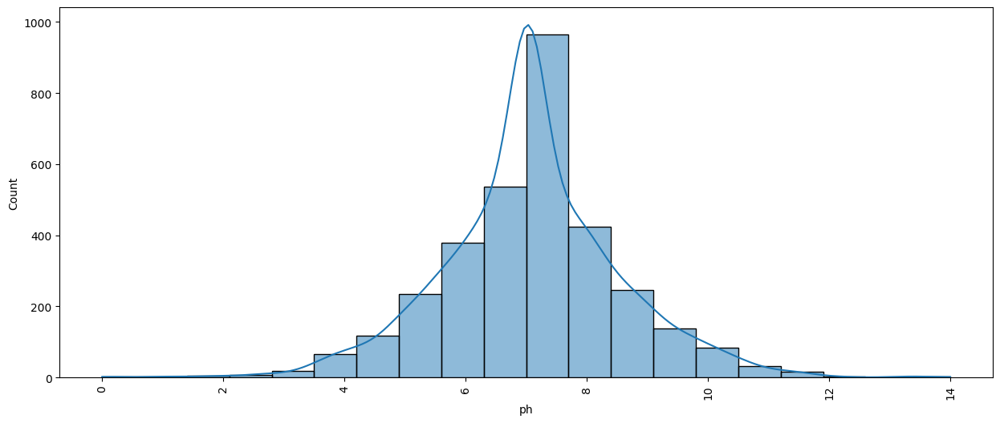

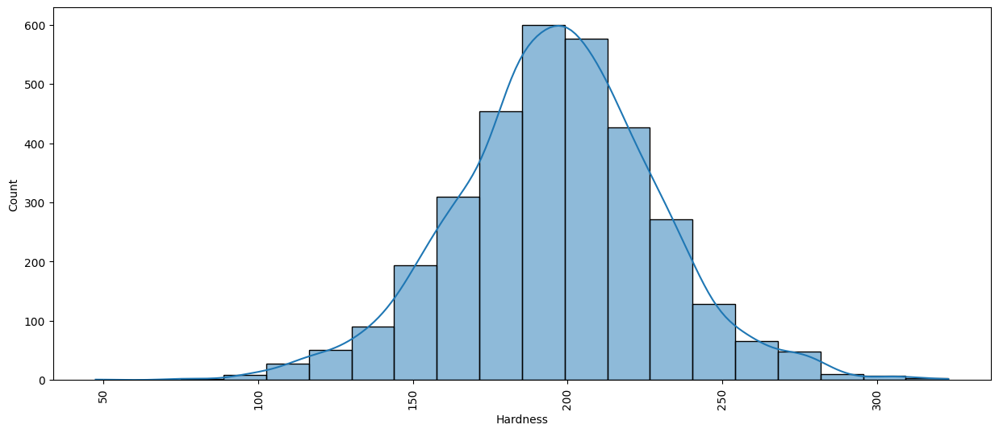

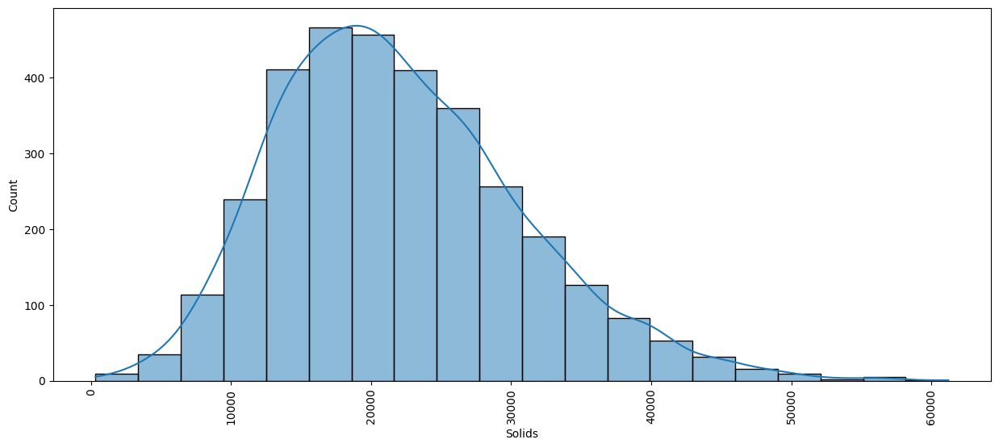

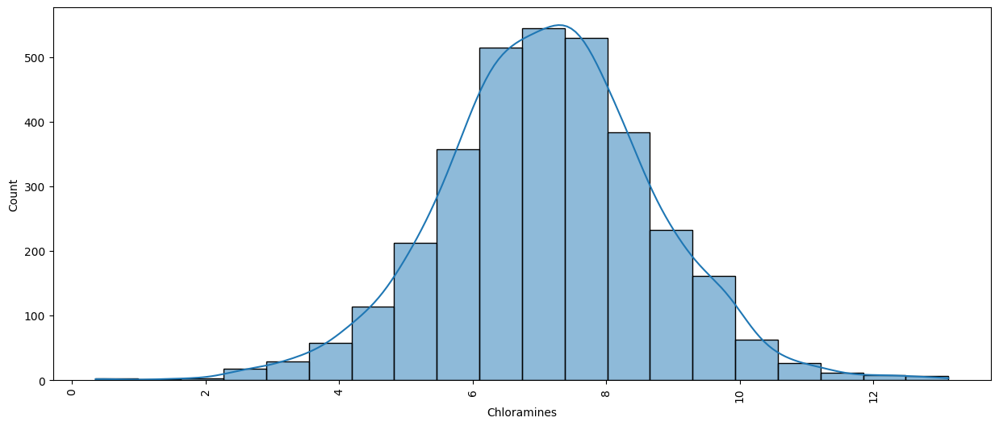

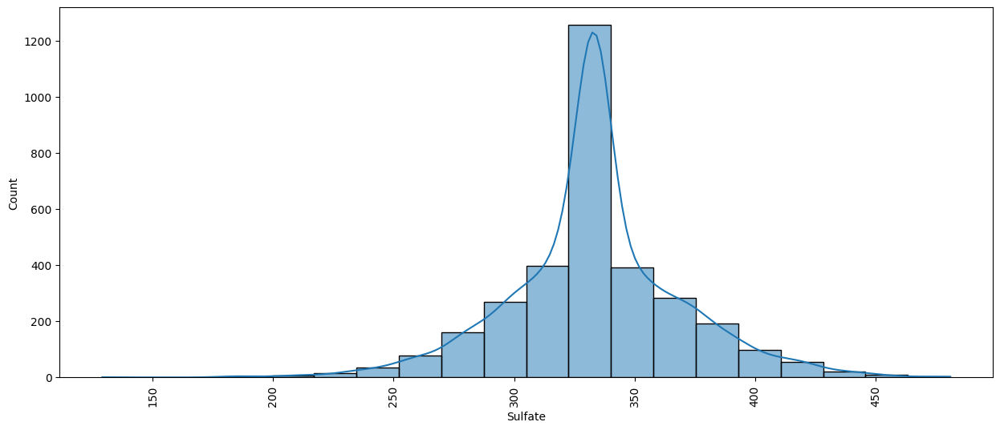

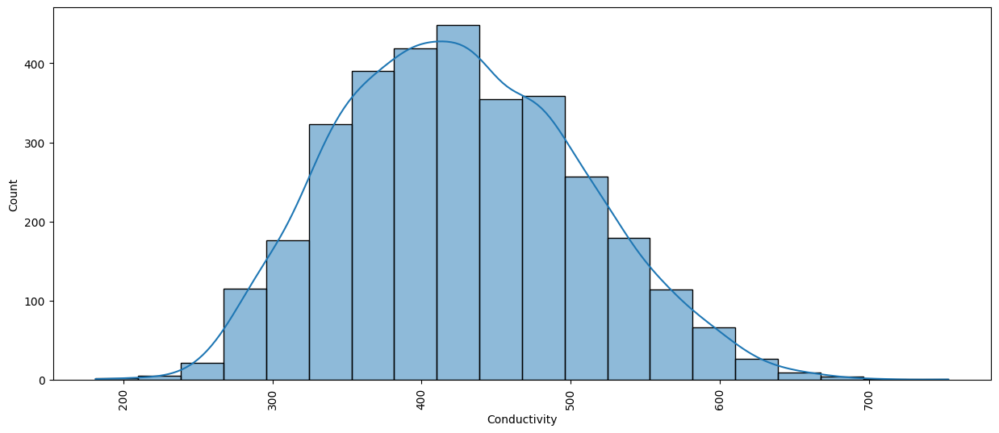

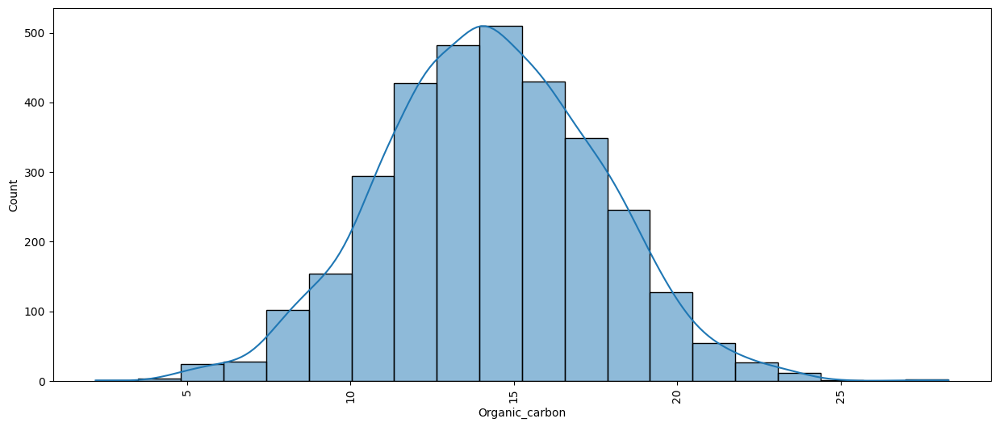

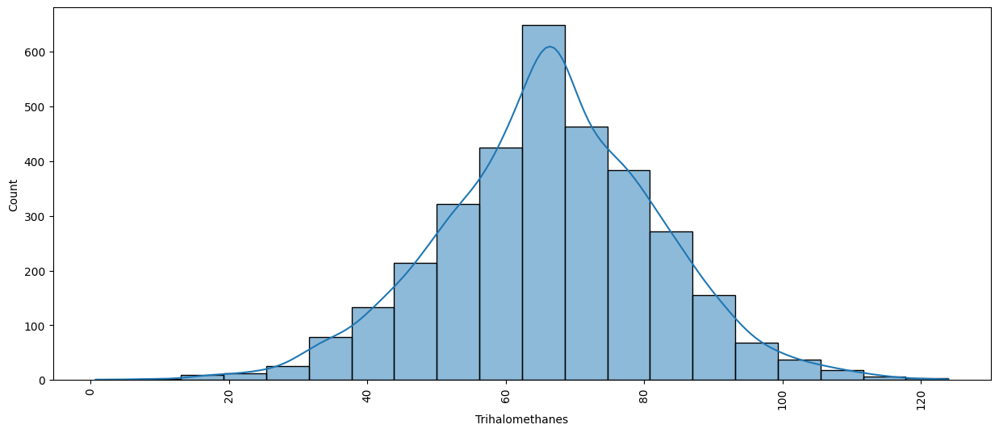

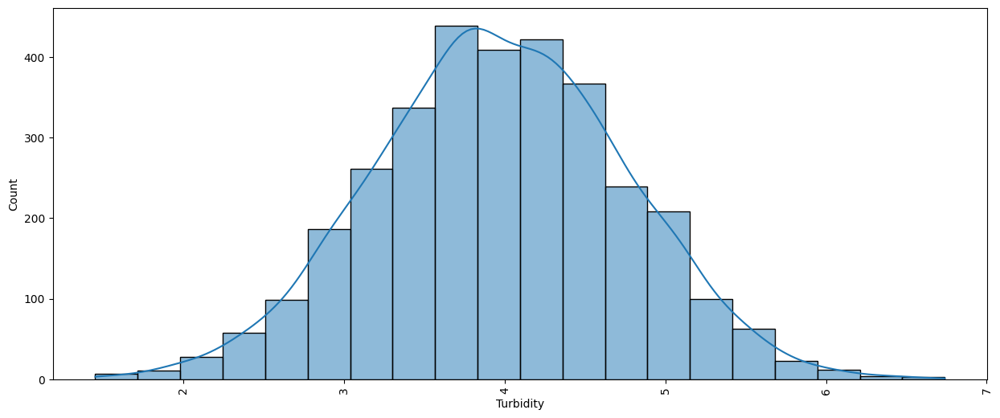

In [52]:
for i in continuous:
    plt.figure(figsize=(15,6))
    sns.histplot(df[i], bins = 20, kde = True, palette='hls')
    plt.xticks(rotation = 90)
    plt.show()

# Models training & Testing

In [53]:
X = df2.drop('Potability', axis=1)
y = df2['Potability']

In [54]:
from sklearn.model_selection import train_test_split

In [55]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, stratify = y,
                                                    random_state=42)

In [56]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
X_train_sc = sc.fit_transform(X_train)
X_test_sc = sc.transform(X_test)

In [57]:
from imblearn.over_sampling import SMOTE

In [58]:
smote = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train, y_train)

In [59]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, accuracy_score

In [60]:
log_reg = LogisticRegression(random_state=42)
log_reg.fit(X_train_resampled, y_train_resampled)

LogisticRegression(random_state=42)

In [61]:
y_pred = log_reg.predict(X_test)

In [62]:
print("Logistic Regression:")
print("Accuracy:", accuracy_score(y_test, y_pred))
print(classification_report(y_test, y_pred))

Logistic Regression:
Accuracy: 0.5056179775280899
              precision    recall  f1-score   support

           0       0.63      0.51      0.56       335
           1       0.38      0.50      0.43       199

    accuracy                           0.51       534
   macro avg       0.50      0.50      0.50       534
weighted avg       0.54      0.51      0.51       534



In [63]:
from sklearn.svm import SVC

In [64]:
smote = SMOTE(random_state=42)
X_train_resampled_new, y_train_resampled_new = smote.fit_resample(X_train_sc, y_train)

In [65]:
svc = SVC(random_state=42)
svc.fit(X_train_resampled_new, y_train_resampled_new)

SVC(random_state=42)

In [66]:
y_pred = svc.predict(X_test)

In [67]:
print("Support Vector Classifier:")
print("Accuracy:", accuracy_score(y_test, y_pred))
print(classification_report(y_test, y_pred))

Support Vector Classifier:
Accuracy: 0.6273408239700374
              precision    recall  f1-score   support

           0       0.63      1.00      0.77       335
           1       0.00      0.00      0.00       199

    accuracy                           0.63       534
   macro avg       0.31      0.50      0.39       534
weighted avg       0.39      0.63      0.48       534



In [68]:
from sklearn.tree import DecisionTreeClassifier

In [69]:

dtc = DecisionTreeClassifier(random_state=42)
dtc.fit(X_train_resampled, y_train_resampled)

DecisionTreeClassifier(random_state=42)

In [70]:
y_pred = dtc.predict(X_test)

In [71]:
print("Decision Tree Classifier:")
print("Accuracy:", accuracy_score(y_test, y_pred))
print(classification_report(y_test, y_pred))

Decision Tree Classifier:
Accuracy: 0.5674157303370787
              precision    recall  f1-score   support

           0       0.67      0.60      0.64       335
           1       0.43      0.51      0.47       199

    accuracy                           0.57       534
   macro avg       0.55      0.56      0.55       534
weighted avg       0.58      0.57      0.57       534



In [72]:
dtc_new = DecisionTreeClassifier(random_state=42)
dtc.fit(X_train_resampled_new, y_train_resampled_new)

DecisionTreeClassifier(random_state=42)

In [73]:
from sklearn.model_selection import GridSearchCV

In [74]:
param_grid_log_reg = {
    'C': [0.1, 1, 10, 100],
    'solver': ['liblinear', 'lbfgs']
}

In [75]:
log_reg = LogisticRegression(random_state=42)
grid_search_log_reg = GridSearchCV(log_reg, param_grid_log_reg, cv=5, scoring='accuracy')
grid_search_log_reg.fit(X_train_resampled, y_train_resampled)

best_log_reg = grid_search_log_reg.best_estimator_
y_pred_log_reg = best_log_reg.predict(X_test)

print("Best Logistic Regression parameters:", grid_search_log_reg.best_params_)
print("Accuracy:", accuracy_score(y_test, y_pred_log_reg))
print(classification_report(y_test, y_pred_log_reg))

Best Logistic Regression parameters: {'C': 1, 'solver': 'liblinear'}
Accuracy: 0.5093632958801498
              precision    recall  f1-score   support

           0       0.63      0.52      0.57       335
           1       0.38      0.49      0.43       199

    accuracy                           0.51       534
   macro avg       0.51      0.51      0.50       534
weighted avg       0.54      0.51      0.52       534



In [76]:
param_grid_dtc = {
    'criterion': ['gini', 'entropy'],
    'max_depth': [None, 10, 20, 30, 40, 50],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

In [77]:
dtc = DecisionTreeClassifier(random_state=42)
grid_search_dtc = GridSearchCV(dtc, param_grid_dtc, cv=5, scoring='accuracy')
grid_search_dtc.fit(X_train_resampled, y_train_resampled)

best_dtc = grid_search_dtc.best_estimator_
y_pred_dtc = best_dtc.predict(X_test)

print("Best Decision Tree parameters:", grid_search_dtc.best_params_)
print("Accuracy:", accuracy_score(y_test, y_pred_dtc))
print(classification_report(y_test, y_pred_dtc))

Best Decision Tree parameters: {'criterion': 'gini', 'max_depth': 20, 'min_samples_leaf': 1, 'min_samples_split': 5}
Accuracy: 0.5561797752808989
              precision    recall  f1-score   support

           0       0.67      0.58      0.62       335
           1       0.42      0.52      0.47       199

    accuracy                           0.56       534
   macro avg       0.55      0.55      0.54       534
weighted avg       0.58      0.56      0.56       534



In [78]:
param_grid_svc = {
    'C': [0.1, 1, 10, 100],
    'gamma': [1, 0.1, 0.01, 0.001],
    'kernel': ['linear','poly', 'rbf','sigmoid']
}

In [79]:
dtc = DecisionTreeClassifier(random_state=42)
grid_search_dtc = GridSearchCV(dtc, param_grid_dtc, cv=5, scoring='accuracy')
grid_search_dtc.fit(X_train_resampled, y_train_resampled)

best_dtc = grid_search_dtc.best_estimator_
y_pred_dtc = best_dtc.predict(X_test)

print("Best Decision Tree parameters:", grid_search_dtc.best_params_)
print("Accuracy:", accuracy_score(y_test, y_pred_dtc))
print(classification_report(y_test, y_pred_dtc))

Best Decision Tree parameters: {'criterion': 'gini', 'max_depth': 20, 'min_samples_leaf': 1, 'min_samples_split': 5}
Accuracy: 0.5561797752808989
              precision    recall  f1-score   support

           0       0.67      0.58      0.62       335
           1       0.42      0.52      0.47       199

    accuracy                           0.56       534
   macro avg       0.55      0.55      0.54       534
weighted avg       0.58      0.56      0.56       534

